In [3]:
%load_ext autoreload
%autoreload 2
import numpy as np
import pandas as p
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
from scipy.spatial import distance
from scipy.stats.mstats import gmean
from sklearn.linear_model import LinearRegression
%matplotlib inline
from itertools import combinations
from itertools import chain
import sys
import os
import copy
sns.set_style('white')
sns.set_style('ticks')
sns.set_color_codes()

fgm_simulation_path = '/Users/grantkinsler/Documents/Stanford/Research/StarryNight/Git/starry-night/Simulations/FGM_simulation_callable.py'
sys.path.append(os.path.dirname(os.path.expanduser(fgm_simulation_path)))
from FGM_simulation_callable import simulation, nball_pull, gaussian_fitness

tools_path = '../code/tools.py'
sys.path.append(os.path.dirname(os.path.expanduser(tools_path)))
import tools
from tools import mutant_colorset
from tools import condition_colorset

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [71]:
cov_thresh = 1e6
# fitness_data = p.read_csv('../data/fitnesses_merged_NoWeight_plusflat_resample1000000.csv')
# fitness_data = p.read_csv('../data/fitnesses_merged_NoWeight_wTechnicalandResamples_ByTimepoint.csv')
# fitness_data = p.read_csv('../data/fitnesses_merged_NoWeight_wTechnical_ByTimepoint.csv')
fitness_data = p.read_csv('../data/fitnesses_merged_default_technical_timepoint.csv')

In [72]:
df_merged_predictions = p.read_csv('../../StarryNight/fitness_prediction_40x_pergen_moreneutrals_BATCH_master_100steps_stepsize2_2xmax_D1to6.csv',index_col=0)

df_merged_predictions = df_merged_predictions[df_merged_predictions['dimension']==0]

barcodes = np.unique(df_merged_predictions['barcode'].values)
conditions = np.unique(df_merged_predictions['condition'].values)

fitnesses = {}

for condition in conditions:
    fitnesses[condition] = []
    for bc in barcodes:
        fitnesses[condition].append(8*df_merged_predictions[(df_merged_predictions['barcode']==bc) & (df_merged_predictions['condition']==condition)]['fitness'].values[0])

In [6]:
old_data = p.DataFrame()
old_data['barcode'] = barcodes
for condition in conditions:
    old_data[f'{condition}_fitness'] = fitnesses[condition]
merged_fitness_data = p.merge(fitness_data,old_data,on='barcode')

In [7]:
mutant_train_set = p.read_csv('../data/mutant_train_set.csv')
training_bcs = mutant_train_set['barcode'].values

mutant_minimal_train_set = p.read_csv('../data/mutant_minimal_train_set.csv')
minimal_training_bcs = mutant_minimal_train_set['barcode'].values

mutant_minimal_train_set = p.read_csv('../data/mutant_minimal_test_set.csv')
minimal_testing_bcs = mutant_minimal_train_set['barcode'].values

In [48]:
old_conditions = {
                  '3':['3.1','3.2','3.3'],
                  '6':['6.1','6.2','6.3'],
                  '13':['13.1','13.2','13.3'],
                  '18':['18.1','18.2','18.3'],
                  '20':['20.1','20.2','20.3'],
                  '21':['21.1','21.2','21.3'],
                  '23':['23.1','23.2','23.3']
                 }

bigbatch_conditions = {
                        '1BB_M3':['A','B','C','D'],
                        '1BB_Baffle':['E','F'],
                        '1BB_1.4%Gluc' :['G','H'],
                        '1BB_1.8%Gluc' :['I','J'],
                        '1BB_0.2MNaCl' :['K','L'],
#                         '1BB_0.2MNaCl' :['K'], 
                        '1BB_0.5MNaCl' :['M','N'],
                        '1BB_0.2MKCl' :['O'],
                        '1BB_0.5MKCl' :['P'],
                        '1BB_8.5uMGdA' :['Q','R'],
                        '1BB_17uMGdA' :['S','T'],
                        '1BB_2ugFlu' :['U','V'],
                        '1BB_0.5ugFlu' :['W','X'],
                        '1BB_1%Raf' :['Y','Z'],
                        '1BB_0.5%Raf' :['AA','BB'],
                        '1BB_1%Gly' :['CC','DD'],
                        '1BB_1%EtOH' :['EE','FF'],
                        '1BB_SucRaf' :['GG'],
                      }

old_nonm3_conditions = [
#     '1.4Glucose', '1.6Glucose', '1.7Glucose', '1.8Glucose',
       '2.5Glucose', '24_Hour_Transfer_PC', 'Benomyl_2ug/mL',
       'DMSO', 'Ferm_40_Hour_Transfer', 'Ferm_44_Hour_Transfer',
       'Ferm_50_Hour_Transfer', 'Ferm_54_Hour_Transfer',
       'Fluconazole_2ug/mL', 'Geldanamycin8.5uM','Radicicol_5uM', 'Resp_5_Day_Transfer',
       'Resp_7_Day_Transfer']

# m3_conditions = {**old_conditions,}
conditions = {**old_conditions, **bigbatch_conditions}
all_conditions = conditions.keys()
all_reps = [rep for reps in conditions.values() for rep in reps]

m3_conditions = list(old_conditions.keys()) + ['1BB_M3']
m3_reps = [rep for condition in m3_conditions for rep in conditions[condition]]



In [49]:
full_neutral_list = [17615,18486,42040,45014,58284,63611,73731,74185,80465,94896
,120600,125697,132511,134852,135750,190551,228237,238783,255561,298344
,308537,316954,317346,335717,411685,454359,469053] 

### from previous list but never has fitness above 3.5% (per gen) in any of 5000bc experiments
supergood_neutral = [17615, 24362, 42040, 71926, 72939, 73802, 80465, 109476, 113483, 
                     134852, 135750, 238783, 263665, 276406, 316954, 335717, 454359] 

### pulled from supergood list and spiked into 1BigBatch experiments
neutral_spikes = [17615,24362,42040,71926,73802,109476,113483,134852,263665,316954]

# neutrals = full_neutral_list
neutrals = list(np.unique(full_neutral_list+supergood_neutral+neutral_spikes))

In [50]:
this_data = fitness_data
this_data = this_data.replace([np.inf, -np.inf], np.nan)
this_data = this_data.dropna('columns',how='all')
this_data = this_data.dropna()

this_data = this_data.sort_values('barcode')

fitness_cols = [col for col in this_data.columns if '_fitness' in col]

fitness = this_data[fitness_cols].values

n_mutants = fitness.shape[0]
n_conditions = fitness.shape[1]


In [51]:
this_data[this_data['barcode'].isin(neutrals)]

,13.1_error,13.1_fitness,13.2_error,13.2_fitness,13.3_error,13.3_fitness,18.1_error,18.1_fitness,18.2_error,18.2_fitness,...,SVX3.2_error,SVX3.2_fitness,SVX3.3_error,SVX3.3_fitness,SVX6.1_error,SVX6.1_fitness,SVX6.2_error,SVX6.2_fitness,SVX6.3_error,SVX6.3_fitness


In [52]:
print(n_mutants,n_conditions)

315 115


In [54]:
this_data = merged_fitness_data
this_data = this_data.replace([np.inf, -np.inf], np.nan)
this_data = this_data.dropna('columns',how='all')
this_data = this_data.dropna()

this_data = this_data.sort_values('barcode')

train_cols = [col + '_fitness' for col in m3_conditions]
test_cols = [col + '_fitness' for col in bigbatch_conditions.keys() if (col + '_fitness') not in train_cols]
test_cols = test_cols + [col + '_fitness' for col in old_nonm3_conditions]

fitness_cols = train_cols + test_cols

fitness = this_data[fitness_cols].values

n_mutants = fitness.shape[0]
n_conditions = fitness.shape[1]

# train_cols = [col+'_original_fitness' for col in [col.split('_')[0] for col in fitness_cols] if col in m3_reps]
# test_cols =  [col+'_original_fitness'  for col in [col.split('_')[0] for col in fitness_cols] if col not in m3_reps]



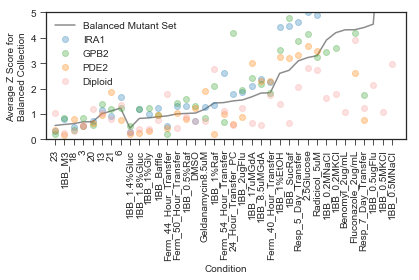

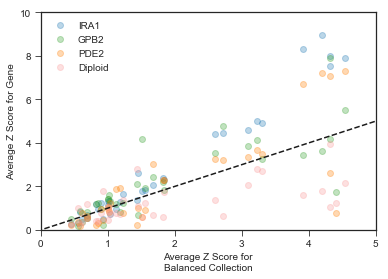

In [68]:
train_means = np.nanmean(this_data[train_cols].values,axis=1)
repeated_means = np.repeat(train_means,len(test_cols)).reshape(len(train_means),len(test_cols))
train_stds = np.nanstd(this_data[train_cols].values,axis=1)
repeated_stds = np.repeat(train_stds,len(test_cols)).reshape(len(train_stds),len(test_cols))
test_z_scores = np.abs((this_data[test_cols].values-repeated_means)/repeated_stds)

train_means = np.nanmean(this_data[train_cols].values,axis=1)
repeated_means = np.repeat(train_means,len(train_cols)).reshape(len(train_means),len(train_cols))
train_stds = np.nanstd(this_data[train_cols].values,axis=1)
repeated_stds = np.repeat(train_stds,len(train_cols)).reshape(len(train_stds),len(train_cols))
train_z_scores = np.abs((this_data[train_cols].values-repeated_means)/repeated_stds)

sorted_test_cols = np.asarray(test_cols)[np.argsort(np.mean(test_z_scores,axis=0))]
sorted_train_cols = np.asarray(train_cols)[np.argsort(np.mean(train_z_scores,axis=0))]
# plt.plot(sorted(np.mean(train_z_scores,axis=0))+sorted(np.mean(test_z_scores,axis=0)),'o',label='All Mutants (dominated by Diploids)')


all_cols = list(sorted_train_cols)+list(sorted_test_cols)
plt.xticks(range(len(all_cols)),[col.split('_fitness')[0] for col in (all_cols)],rotation=90)


used_mutants = [bc for bc in this_data['barcode'].values if bc in (list(minimal_training_bcs) + list(minimal_testing_bcs))]
      
    

all_mut_locs =sorted(list(np.where(np.isin(this_data['barcode'].values,used_mutants))[0]))


train_means = np.nanmean(this_data[train_cols].values[all_mut_locs,:],axis=1)
repeated_means = np.repeat(train_means,len(test_cols)).reshape(len(train_means),len(test_cols))
train_stds = np.nanstd(this_data[train_cols].values[all_mut_locs,:],axis=1)
repeated_stds = np.repeat(train_stds,len(test_cols)).reshape(len(train_stds),len(test_cols))
test_z_scores = np.abs((this_data[test_cols].values[all_mut_locs,:]-repeated_means)/repeated_stds)

train_means = np.nanmean(this_data[train_cols].values[all_mut_locs,:],axis=1)
repeated_means = np.repeat(train_means,len(train_cols)).reshape(len(train_means),len(train_cols))
train_stds = np.nanstd(this_data[train_cols].values[all_mut_locs,:],axis=1)
repeated_stds = np.repeat(train_stds,len(train_cols)).reshape(len(train_stds),len(train_cols))
train_z_scores = np.abs((this_data[train_cols].values[all_mut_locs,:]-repeated_means)/repeated_stds)

mean_train_z_scores = train_z_scores
mean_test_z_scores = test_z_scores

sorted_test_cols = np.asarray(test_cols)[np.argsort(np.mean(test_z_scores,axis=0))]
sorted_train_cols = np.asarray(train_cols)[np.argsort(np.mean(train_z_scores,axis=0))]
plt.plot(sorted(np.mean(train_z_scores,axis=0))+sorted(np.mean(test_z_scores,axis=0)),'-',color='k',alpha=0.5,label='Balanced Mutant Set')


all_cols = list(sorted_train_cols)+list(sorted_test_cols)
plt.xticks(range(len(all_cols)),[col.split('_fitness')[0] for col in (all_cols)],rotation=90)

plt.legend()
# plt.ylim(0,7)
plt.xlim(-1,len(train_conditions)+len(test_conditions)+0.5)
plt.ylabel('Average Z Score for\nBalanced Collection')
plt.xlabel('Condition')

plt.tight_layout()

plt.savefig('z_scores_minimal_comparison.pdf',bbox_inches='tight')

gene_list = ['IRA1','GPB2','PDE2','Diploid']
for gene in gene_list:
    
    used_mutants = [bc for bc in this_data[this_data['gene']==gene]['barcode'].values]
    all_mut_locs =sorted(list(np.where(np.isin(this_data['barcode'].values,used_mutants))[0]))


    train_means = np.nanmean(this_data[train_cols].values[all_mut_locs,:],axis=1)
    repeated_means = np.repeat(train_means,len(test_cols)).reshape(len(train_means),len(test_cols))
    train_stds = np.nanstd(this_data[train_cols].values[all_mut_locs,:],axis=1)
    repeated_stds = np.repeat(train_stds,len(test_cols)).reshape(len(train_stds),len(test_cols))
    test_z_scores = np.abs((this_data[test_cols].values[all_mut_locs,:]-repeated_means)/repeated_stds)

    train_means = np.nanmean(this_data[train_cols].values[all_mut_locs,:],axis=1)
    repeated_means = np.repeat(train_means,len(train_cols)).reshape(len(train_means),len(train_cols))
    train_stds = np.nanstd(this_data[train_cols].values[all_mut_locs,:],axis=1)
    repeated_stds = np.repeat(train_stds,len(train_cols)).reshape(len(train_stds),len(train_cols))
    train_z_scores = np.abs((this_data[train_cols].values[all_mut_locs,:]-repeated_means)/repeated_stds)

    sorted_test_cols = np.asarray(test_cols)[np.argsort(np.mean(mean_test_z_scores,axis=0))]
    sorted_train_cols = np.asarray(train_cols)[np.argsort(np.mean(mean_train_z_scores,axis=0))]
    plt.plot((list(np.mean(train_z_scores,axis=0)[np.argsort(np.mean(mean_train_z_scores,axis=0))])+
              list(np.mean(test_z_scores,axis=0)[np.argsort(np.mean(mean_test_z_scores,axis=0))]))
             ,'o',color=mutant_colorset[gene],alpha=0.3,label=gene)
plt.legend()
# plt.axhline(2.0)

plt.savefig('z_scores_minimal_comparison_plusmore.pdf',bbox_inches='tight')

plt.ylim(0,5)
plt.savefig('z_scores_minimal_comparison_plusmore_zoomed.pdf',bbox_inches='tight')   


gene_list = ['IRA1','GPB2','PDE2','Diploid']
plt.figure()
for gene in gene_list:
    
#     plt.figure()
    
#     plt.title(gene)
    
    used_mutants = [bc for bc in this_data[this_data['gene']==gene]['barcode'].values]
    all_mut_locs =sorted(list(np.where(np.isin(this_data['barcode'].values,used_mutants))[0]))


    train_means = np.nanmean(this_data[train_cols].values[all_mut_locs,:],axis=1)
    repeated_means = np.repeat(train_means,len(test_cols)).reshape(len(train_means),len(test_cols))
    train_stds = np.nanstd(this_data[train_cols].values[all_mut_locs,:],axis=1)
    repeated_stds = np.repeat(train_stds,len(test_cols)).reshape(len(train_stds),len(test_cols))
    test_z_scores = np.abs((this_data[test_cols].values[all_mut_locs,:]-repeated_means)/repeated_stds)

    train_means = np.nanmean(this_data[train_cols].values[all_mut_locs,:],axis=1)
    repeated_means = np.repeat(train_means,len(train_cols)).reshape(len(train_means),len(train_cols))
    train_stds = np.nanstd(this_data[train_cols].values[all_mut_locs,:],axis=1)
    repeated_stds = np.repeat(train_stds,len(train_cols)).reshape(len(train_stds),len(train_cols))
    train_z_scores = np.abs((this_data[train_cols].values[all_mut_locs,:]-repeated_means)/repeated_stds)

    sorted_test_cols = np.asarray(test_cols)[np.argsort(np.mean(mean_test_z_scores,axis=0))]
    sorted_train_cols = np.asarray(train_cols)[np.argsort(np.mean(mean_train_z_scores,axis=0))]
#     plt.plot((list(np.mean(train_z_scores,axis=0)[np.argsort(np.mean(mean_train_z_scores,axis=0))])+
#               list(np.mean(test_z_scores,axis=0)[np.argsort(np.mean(mean_test_z_scores,axis=0))]))
#              ,'o',color=mutant_colorset[gene],alpha=0.3,label=gene)
    
    
    plt.plot((list(np.mean(mean_train_z_scores,axis=0)[np.argsort(np.mean(mean_train_z_scores,axis=0))])+
              list(np.mean(mean_test_z_scores,axis=0)[np.argsort(np.mean(mean_test_z_scores,axis=0))])),
             (list(np.mean(train_z_scores,axis=0)[np.argsort(np.mean(mean_train_z_scores,axis=0))])+
              list(np.mean(test_z_scores,axis=0)[np.argsort(np.mean(mean_test_z_scores,axis=0))]))
             ,'o',color=mutant_colorset[gene],alpha=0.3,label=gene)
xmin,xmax = plt.xlim()
ymin,ymax = plt.ylim()
onetoone = [min([xmin,ymin]),max([xmax,ymax])]
plt.plot(onetoone,onetoone,'k--')
plt.legend()
plt.xlabel('Average Z Score for\nBalanced Collection')
plt.ylabel('Average Z Score for Gene')
plt.xlim(0,20)
plt.savefig('z_score_comparison_allgenes.pdf')

plt.xlim(0,5)
plt.ylim(0,10)
plt.savefig('z_score_comparison_allgenes_zoomed.pdf')
    
    




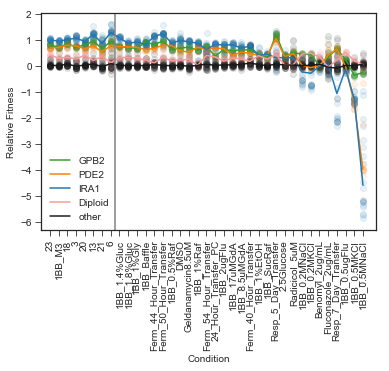

In [70]:
# test_mutant_data = this_data[~this_data['barcode'].isin(minimal_training_bcs)]

mutant_data = this_data[this_data['barcode'].isin((list(minimal_training_bcs)+list(minimal_testing_bcs)))]

train_conditions = sorted_train_cols
test_conditions = sorted_test_cols


this_gene = ['GPB2','PDE2','IRA1','Diploid','other']
# this
this_gene_data = mutant_data[mutant_data['gene'].isin(this_gene)]


this_gene_locs = np.where(np.isin(mutant_data['barcode'].values,this_gene_data['barcode'].values))[0]
jitters = [tools.jitter_point(0,0.01) for bc in range(len(this_gene_data[train_conditions[0]].values)) ]

plt.figure()
# plt.title(f'Predictions with {rank+1} components')
for i,col in enumerate(train_conditions):
    for bc in range(len(this_gene_data[col].values)):
        plt.scatter([i + 1 + jitters[bc]],this_gene_data[col].values[bc],alpha=0.1,color=mutant_colorset[this_gene_data['gene'].values[bc]]) 

for i,col in enumerate(test_conditions):
    for bc in range(len(this_gene_data[col].values)):
        plt.scatter([len(train_conditions)+i + 1 + jitters[bc]],this_gene_data[col].values[bc],alpha=0.1,color=mutant_colorset[this_gene_data['gene'].values[bc]]) 

for gene in this_gene:
    this_gene_data = mutant_data[mutant_data['gene']==gene]
    data = np.median(np.asarray([this_gene_data[col].values for col in (list(train_conditions) + list(test_conditions))]),axis=1)
    plt.plot(range(1,len((list(train_conditions) + list(test_conditions)))+1),data,alpha=1.0,color=mutant_colorset[gene],label=gene)

plt.axvline(x=len(train_conditions)+0.5,color='gray')
plt.legend()
plt.xticks(range(1,len(train_conditions)+len(test_conditions)+1),[col.split('_fitness')[0] for col in (list(train_conditions) + list(test_conditions))],rotation=90)

# plt.ylim(-0.5,1.8)
plt.xlim(0.0,len(train_conditions)+len(test_conditions)+1.5)
plt.ylabel('Relative Fitness')
plt.xlabel('Condition')

plt.savefig('relative_fitness_line_dots_noylim.pdf',bbox_inches='tight')

In [69]:
# test_mutant_data = this_data[~this_data['barcode'].isin(minimal_training_bcs)]

mutant_data = this_data[this_data['barcode'].isin((list(minimal_training_bcs)+list(minimal_testing_bcs)))]

train_conditions = sorted_train_cols
test_conditions = sorted_test_cols


this_gene = ['GPB2','PDE2','IRA1','Diploid','other']
# this
this_gene_data = mutant_data[mutant_data['gene'].isin(this_gene)]


this_gene_locs = np.where(np.isin(mutant_data['barcode'].values,this_gene_data['barcode'].values))[0]
jitters = [tools.jitter_point(0,0.01) for bc in range(len(this_gene_data[train_conditions[0]].values)) ]

plt.figure()
# plt.title(f'Predictions with {rank+1} components')
for i,col in enumerate(train_conditions):
    for bc in range(len(this_gene_data[col].values)):
        plt.scatter([i + 1 + jitters[bc]],this_gene_data[col].values[bc],alpha=0.1,color=mutant_colorset[this_gene_data['gene'].values[bc]]) 

for i,col in enumerate(test_conditions):
    for bc in range(len(this_gene_data[col].values)):
        plt.scatter([len(train_conditions)+i + 1 + jitters[bc]],this_gene_data[col].values[bc],alpha=0.1,color=mutant_colorset[this_gene_data['gene'].values[bc]]) 

for gene in this_gene:
    this_gene_data = mutant_data[mutant_data['gene']==gene]
    data = np.median(np.asarray([this_gene_data[col].values for col in (list(train_conditions) + list(test_conditions))]),axis=1)
    plt.plot(range(1,len((list(train_conditions) + list(test_conditions)))+1),data,alpha=1.0,color=mutant_colorset[gene],label=gene)

plt.axvline(x=len(train_conditions)+0.5,color='gray')
plt.legend()
plt.xticks(range(1,len(train_conditions)+len(test_conditions)+1),[col.split('_fitness')[0] for col in (list(train_conditions) + list(test_conditions))],rotation=90)

# plt.ylim(-0.5,1.8)
plt.xlim(0.0,len(train_conditions)+len(test_conditions)+1.5)
plt.ylabel('Relative Fitness')
plt.xlabel('Condition')

plt.savefig('relative_fitness_line_dots_noylim.pdf',bbox_inches='tight')

39

In [34]:
# train_cols = list(sorted_train_cols) + list(sorted_test_cols[np.where(np.asarray(sorted(np.mean(test_z_scores,axis=0)))<2)[0]])
# test_cols = list(sorted_test_cols[np.where(np.asarray(sorted(np.mean(test_z_scores,axis=0)))>2)[0]])

train_cols = list(sorted_train_cols) + list(sorted_test_cols[:7])
test_cols = list(sorted_test_cols[7:])

In [35]:
np.unique(this_data['gene'].values)

array(['CYR1', 'Diploid', 'Diploid + Chr11Amp', 'Diploid + IRA1',
       'Diploid + IRA2', 'GPB1', 'GPB2', 'IRA1', 'IRA2', 'KOG1',
       'NotSequenced', 'PDE2', 'RAS2', 'SCH9', 'TFS1', 'TOR1', 'other'],
      dtype=object)

['Diploid']
['Diploid + Chr11Amp', 'Diploid + IRA1', 'Diploid + IRA2']
['IRA1']
['IRA2']
['GPB1']
['GPB2']
['PDE2']
['RAS2']
['CYR1']
['TFS1']
['KOG1']
['TOR1']
['SCH9']
['other']


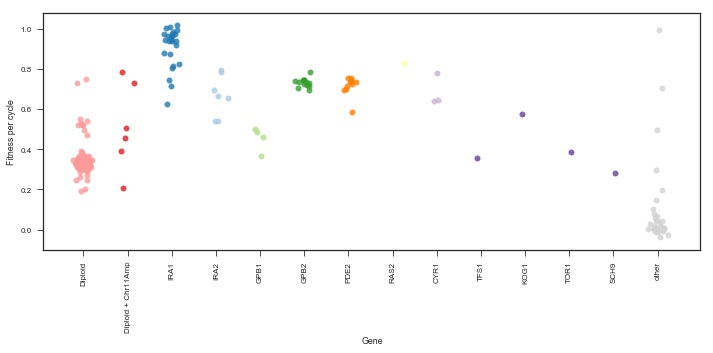

In [36]:
mutant_colorset['other'] = 'lightgray'
mutant_colorset['NotSequenced'] = 'lightgray'

sns.set(style="ticks", context="paper")
# plt.style.use("white")
all_genes = [['Diploid'], ['Diploid + Chr11Amp', 'Diploid + IRA1','Diploid + IRA2'],
                         ['IRA1'], ['IRA2'], ['GPB1'], ['GPB2'],  ['PDE2'],
                         ['RAS2'],['CYR1'],['TFS1'], ['KOG1'], ['TOR1'], ['SCH9'],['other']]

plt.figure(figsize=(10,5))
for g,gene in enumerate(all_genes):
    if type(gene) == str:
        gene = list(gene)
    print(gene)
    this_gene = this_data[this_data['gene'].isin(gene)]
    
    plt.scatter([tools.jitter_point(g,0.1) for i in range(len(this_gene.index))],this_gene['1BB_M3_fitness'].values,
               c=mutant_colorset[gene[0]],alpha=0.8)
    
    
plt.xticks(range(len(all_genes)),[gene[0] for gene in all_genes],rotation=90)
plt.ylabel('Fitness per cycle')
plt.xlabel('Gene')

plt.tight_layout()
# plt.savefig('venkataram_style_plot_dark.pdf',bbox_inches='tight')

['Diploid']
['Diploid + Chr11Amp', 'Diploid + IRA1', 'Diploid + IRA2']
['IRA1']
['IRA2']
['GPB1']
['GPB2']
['PDE2']
['Diploid']
['Diploid + Chr11Amp', 'Diploid + IRA1', 'Diploid + IRA2']
['IRA1']
['IRA2']
['GPB1']
['GPB2']
['PDE2']
['Diploid']
['Diploid + Chr11Amp', 'Diploid + IRA1', 'Diploid + IRA2']
['IRA1']
['IRA2']
['GPB1']
['GPB2']
['PDE2']
['Diploid']
['Diploid + Chr11Amp', 'Diploid + IRA1', 'Diploid + IRA2']
['IRA1']
['IRA2']
['GPB1']
['GPB2']
['PDE2']


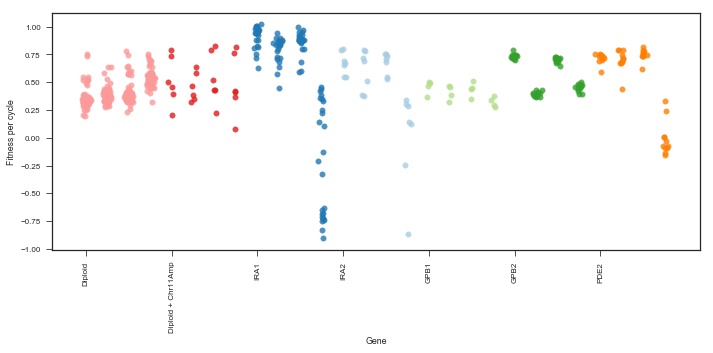

In [37]:
mutant_colorset['other'] = 'lightgray'
mutant_colorset['NotSequenced'] = 'lightgray'

sns.set(style="ticks", context="paper")
# plt.style.use("dark_background")
all_genes = [['Diploid'], ['Diploid + Chr11Amp', 'Diploid + IRA1','Diploid + IRA2'],
                         ['IRA1'], ['IRA2'], ['GPB1'], ['GPB2'],  ['PDE2'],
#                          ['RAS2'],['CYR1'],['TFS1'], ['KOG1'], ['TOR1'], ['SCH9'],['other']
            ]

plt.figure(figsize=(10,5))
for g,gene in enumerate(all_genes):
    if type(gene) == str:
        gene = list(gene)
    print(gene)
    this_gene = this_data[this_data['gene'].isin(gene)]
    
    plt.scatter([tools.jitter_point(g,0.02) for i in range(len(this_gene.index))],this_gene['1BB_M3_fitness'].values,
               c=mutant_colorset[gene[0]],alpha=0.8)

for c,condition in enumerate(['24_Hour_Transfer_PC','1BB_1.8%Gluc','1BB_0.2MKCl']):
    for g,gene in enumerate(all_genes):
        if type(gene) == str:
            gene = list(gene)
        print(gene)
        this_gene = this_data[this_data['gene'].isin(gene)]

        plt.scatter([tools.jitter_point(g+0.25*(c+1),0.02) for i in range(len(this_gene.index))],this_gene[condition+'_fitness'].values,
                   c=mutant_colorset[gene[0]],alpha=0.8)
    
    
plt.xticks(range(len(all_genes)),[gene[0] for gene in all_genes],rotation=90)
plt.ylabel('Fitness per cycle')
plt.xlabel('Gene')

plt.tight_layout()
# plt.savefig('venkataram_style_plot_dark_m3_2mkcl.pdf',bbox_inches='tight')

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/matplotlib/legend.py:593: UserWarning: The handle <matplotlib.lines.Line2D object at 0x135eec668> has a label of '_nolegend_' which cannot be automatically added to the legend.
  'legend.'.format(handle, label))
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/matplotlib/legend.py:593: UserWarning: The handle <matplotlib.collections.PathCollection object at 0x140bab9b0> has a label of '_nolegend_' which cannot be automatically added to the legend.
  'legend.'.format(handle, label))


(-1, 1.6)

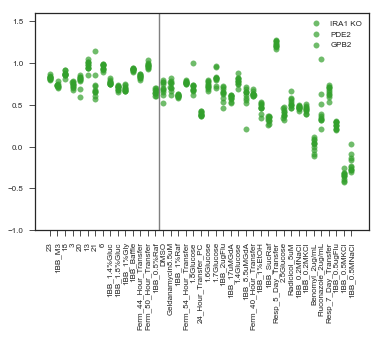

In [58]:
##### test_mutant_data = this_data[~this_data['barcode'].isin(minimal_training_bcs)]

mutant_data = this_data[this_data['barcode'].isin((list(minimal_training_bcs)+list(minimal_testing_bcs)))]

train_conditions = sorted_train_cols
test_conditions = sorted_test_cols

train_conditions = train_cols
test_conditions = test_cols

this_gene = ['other','GPB2','PDE2','IRA1','Diploid']
this_gene = ['GPB2']
# this
this_gene_data = mutant_data[mutant_data['gene'].isin(this_gene)]



this_gene_locs = np.where(np.isin(mutant_data['barcode'].values,this_gene_data['barcode'].values))[0]
jitters = [tools.jitter_point(0,0.01) for bc in range(len(this_gene_data[train_conditions[0]].values)) ]

plt.figure()
# plt.title(f'Predictions with {rank+1} components')
for i,col in enumerate(train_conditions):
    for bc in range(len(this_gene_data[col].values)):
        plt.scatter([i + 1 + jitters[bc]],this_gene_data[col].values[bc],alpha=0.7,color=mutant_colorset[this_gene_data['gene'].values[bc]]) 

for i,col in enumerate(test_conditions):
    for bc in range(len(this_gene_data[col].values)):
        plt.scatter([len(train_conditions)+i + 1 + jitters[bc]],this_gene_data[col].values[bc],alpha=0.7,color=mutant_colorset[this_gene_data['gene'].values[bc]]) 


plt.axvline(x=len(train_conditions)+0.5,color='gray')
plt.legend(['_nolegend_','IRA1 KO','PDE2','_nolegend_','GPB2'])
plt.xticks(range(1,len(train_conditions)+len(test_conditions)+1),[col.split('_fitness')[0] for col in (list(train_conditions) + list(test_conditions))],rotation=90)
plt.ylim(-1,1.6)
    
#     plt.savefig('predictions_by_gene_{rank+1}components.pdf',bbox_inches='tight')

In [ ]:
#### sns.set(style="ticks", context="talk")
# plt.style.use("dark_background")

# test_mutant_data = this_data[~this_data['barcode'].isin(minimal_training_bcs)]

mutant_data = this_data[this_data['barcode'].isin((list(minimal_training_bcs)+list(minimal_testing_bcs)))]

train_conditions = sorted_train_cols
test_conditions = sorted_test_cols

train_conditions = train_cols
test_conditions = test_cols

all_conditions = list(train_conditions) + list(test_conditions)


this_gene = ['other','GPB2','PDE2','IRA1','Diploid']
# this
this_gene_data = mutant_data[mutant_data['gene'].isin(this_gene)]



this_gene_locs = np.where(np.isin(mutant_data['barcode'].values,this_gene_data['barcode'].values))[0]
jitters = [tools.jitter_point(0,0.01) for bc in range(len(this_gene_data[train_conditions[0]].values)) ]

plt.figure(figsize=(10,6))
for gene in this_gene:
    this_gene_data = mutant_data[mutant_data['gene']==gene]
    data = np.median(np.asarray([this_gene_data[col].values for col in all_conditions]),axis=1)
    plt.plot(range(len(all_conditions)),data,alpha=1.0,color=mutant_colorset[gene])
        



#     plt.title(f'Predictions with {rank+1} components')
#     for i,col in enumerate(train_conditions):
#         for bc in range(len(this_gene_data[col].values)):
#             plt.scatter([i + jitters[bc]],this_gene_data[col].values[bc],alpha=0.1,color=mutant_colorset[this_gene_data['gene'].values[bc]]) 

#     for i,col in enumerate(test_conditions):
#         for bc in range(len(this_gene_data[col].values)):
#             plt.scatter([len(train_conditions)+i  + jitters[bc]],this_gene_data[col].values[bc],alpha=0.1,color=mutant_colorset[this_gene_data['gene'].values[bc]]) 


# plt.axvline(x=len(train_conditions)+0.5,color='gray')
# plt.legend(['_nolegend_','IRA1 KO','PDE2','_nolegend_','GPB2'])
plt.xticks(range(0,len(train_conditions)+len(test_conditions)),[col.split('_fitness')[0] for col in (list(train_conditions) + list(test_conditions))],rotation=90)
plt.ylim(-1,1.6)
plt.ylabel('Fitness per cycle')
    
# plt.savefig('all_conditions_fitness_darknoline.pdf',bbox_inches='tight')

DMSO
Geldanamycin8.5uM
1BB_1%Raf
Ferm_54_Hour_Transfer
1.8Glucose
24_Hour_Transfer_PC
1.6Glucose
1.7Glucose
1BB_2ugFlu
1BB_17uMGdA
1.4Glucose
1BB_8.5uMGdA
Ferm_40_Hour_Transfer
1BB_1%EtOH
1BB_SucRaf
Resp_5_Day_Transfer
2.5Glucose
Radicicol_5uM
1BB_0.2MNaCl
1BB_0.2MKCl
Benomyl_2ug/mL
Fluconazole_2ug/mL
Resp_7_Day_Transfer
1BB_0.5ugFlu
1BB_0.5MKCl
1BB_0.5MNaCl
DMSO
Geldanamycin8.5uM
1BB_1%Raf
Ferm_54_Hour_Transfer
1.8Glucose
24_Hour_Transfer_PC
1.6Glucose
1.7Glucose
1BB_2ugFlu
1BB_17uMGdA
1.4Glucose
1BB_8.5uMGdA
Ferm_40_Hour_Transfer
1BB_1%EtOH
1BB_SucRaf
Resp_5_Day_Transfer
2.5Glucose
Radicicol_5uM
1BB_0.2MNaCl
1BB_0.2MKCl
Benomyl_2ug/mL
Fluconazole_2ug/mL
Resp_7_Day_Transfer
1BB_0.5ugFlu
1BB_0.5MKCl
1BB_0.5MNaCl


(-2, 15)

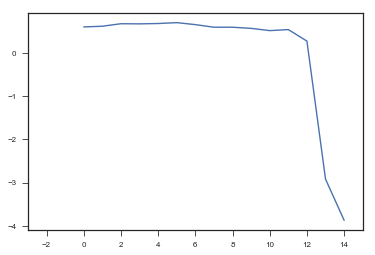

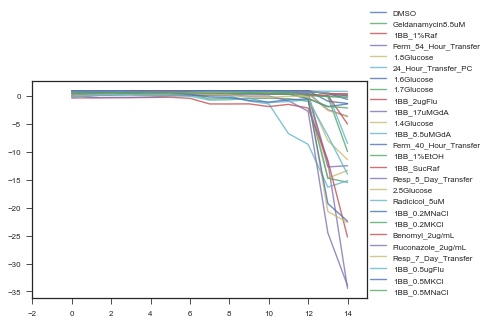

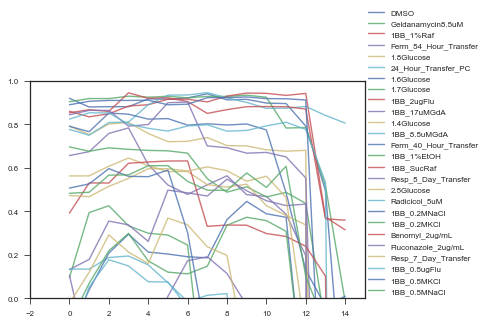

In [40]:

this_data = merged_fitness_data
this_data = this_data.replace([np.inf, -np.inf], np.nan)
this_data = this_data.dropna('columns',how='all')
this_data = this_data.dropna()

this_data = this_data.sort_values('barcode')

# train_cols = [col + '_fitness' for col in m3_conditions]
# test_cols = [col + '_fitness' for col in bigbatch_conditions.keys() if (col + '_fitness') not in train_cols]
# test_cols = test_cols + [col + '_fitness' for col in old_nonm3_conditions]
# train_cols = list(sorted_train_cols) + list(sorted_test_cols)[:5]
# test_cols = list(sorted_test_cols)[5:]

fitness_cols = train_cols + test_cols

fitness = this_data[fitness_cols].values

n_mutants = fitness.shape[0]
n_conditions = fitness.shape[1]

# train_cols = [col+'_original_fitness' for col in [col.split('_')[0] for col in fitness_cols] if col in m3_reps]
# test_cols =  [col+'_original_fitness'  for col in [col.split('_')[0] for col in fitness_cols] if col not in m3_reps]




# fitness_cols = fitness_data.columns

# train_conditions = train_cols

train_conditions = train_cols
# train_conditions = test_cols
train_locs = np.where(np.isin(fitness_cols,train_conditions))[0]

test_conditions = test_cols
# test_conditions = train_cols
# test_conditions = [rep for rep in  test_conditions if rep.split('_')[0] in all_reps]
test_locs = np.where(np.isin(fitness_cols,test_conditions))[0]




all_locs = sorted(list(train_locs)+list(test_locs))

used_mutants = [bc for bc in this_data['barcode'].values if bc in (list(minimal_training_bcs) + list(minimal_testing_bcs))]
                                       
all_mut_locs =sorted(list(np.where(np.isin(this_data['barcode'].values,used_mutants))[0]))

this_fitness = fitness[all_mut_locs,:][:,all_locs]
new_train_locs = np.where(np.isin(all_locs,train_locs))[0]
new_test_locs = np.where(np.isin(all_locs,test_locs))[0]



train = [new_train_locs,np.where(np.isin(used_mutants,minimal_training_bcs))[0]]
test = [new_test_locs,np.where(np.isin(used_mutants,minimal_testing_bcs))[0]]


by_rank, by_condition, by_mutant, mean_fits, guesses = tools.SVD_predictions_train_test(this_fitness,train,test,by_condition=True,by_mutant=True)
by_condition = np.asarray(by_condition).swapaxes(0,1)

condition_colors = sns.color_palette()
plt.plot(by_rank)
plt.xlim(-3,len(by_rank))


plt.figure()
start = 0
already_plotted = []

for k,condition in enumerate(test_conditions):
    condition = condition.split('_fitness')[0]
    print(condition)
#     condition_name = [name for name, reps in conditions.items() for rep in reps if rep == condition][0]
    condition_name = condition
#     index = np.where(np.asarray(list(conditions.keys()))==condition_name)[0][0]
    
    index =  k % len(condition_colors)
    if condition_name not in already_plotted:
        plt.plot(by_condition[k],label=condition_name,color=condition_colors[index],alpha=0.8)
        already_plotted.append(condition_name)
    else:
        plt.plot(by_condition[k],color=condition_colors[index],alpha=0.8)
plt.legend(loc=(1.0,0.0))
plt.xlim(-2,len(by_rank))

plt.figure()
start = 0
already_plotted = []

for k,condition in enumerate(test_conditions):
    condition = condition.split('_fitness')[0]
    print(condition)
#     condition_name = [name for name, reps in conditions.items() for rep in reps if rep == condition][0]
    condition_name = condition
#     index = np.where(np.asarray(list(conditions.keys()))==condition_name)[0][0]
    
    index =  k % len(condition_colors)
    if condition_name not in already_plotted:
        plt.plot(by_condition[k],label=condition_name,color=condition_colors[index],alpha=0.8)
        already_plotted.append(condition_name)
    else:
        plt.plot(by_condition[k],color=condition_colors[index],alpha=0.8)
plt.legend(loc=(1.0,0.0))
plt.ylim(0,1)
plt.xlim(-2,len(by_rank))

In [41]:
this_gene_data

,13.1_error,13.1_fitness,13.2_error,13.2_fitness,13.3_error,13.3_fitness,18.1_error,18.1_fitness,18.2_error,18.2_fitness,...,Fluconazole_2ug/mL_fitness,Geldanamycin8.5uM_fitness,M3_Batch_13_fitness,M3_Batch_18_fitness,M3_Batch_19_allpool_fitness,M3_Batch_3_fitness,M3_Batch_6_PC_fitness,Radicicol_5uM_fitness,Resp_5_Day_Transfer_fitness,Resp_7_Day_Transfer_fitness
73,0.57735,0.218408,0.57735,0.178339,0.57735,0.036556,0.57735,0.232315,0.57735,0.320405,...,-0.111580,0.253944,0.291894,0.258522,0.188990,0.229554,0.169927,0.064343,0.449323,0.227852
116,0.57735,0.220565,0.57735,0.410277,0.57735,0.364764,0.57735,0.350369,0.57735,0.458604,...,0.271131,-0.042067,0.150106,0.280063,0.250316,0.008104,-0.050803,0.222568,0.302044,0.128172
136,0.57735,0.292122,0.57735,0.206686,0.57735,0.180635,0.57735,0.226755,0.57735,0.354072,...,-0.097848,0.278372,0.198754,0.237534,0.286174,0.219823,0.308245,0.285628,0.452454,0.240169
146,0.57735,0.274733,0.57735,0.250029,0.57735,0.135515,0.57735,0.367893,0.57735,0.387253,...,-0.018938,0.269441,0.239167,0.305685,0.260411,0.197633,0.347410,0.008069,0.531466,0.454981
190,0.57735,0.318635,0.57735,0.266374,0.57735,0.198699,0.57735,0.360884,0.57735,0.354058,...,0.357715,0.264653,0.264668,0.265635,0.234119,0.262496,0.159727,0.275630,0.445564,0.375929
224,0.57735,0.214114,0.57735,0.124172,0.57735,0.124523,0.57735,0.244454,0.57735,0.347320,...,-0.041354,0.245619,0.128835,0.162027,0.257195,0.324361,0.364592,-0.065239,0.524401,0.317411
277,0.57735,0.241887,0.57735,0.178347,0.57735,0.147625,0.57735,0.299990,0.57735,0.383618,...,-0.068956,0.277154,0.346625,0.319411,0.260598,0.202068,0.227911,-0.096922,0.423945,0.221495


/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


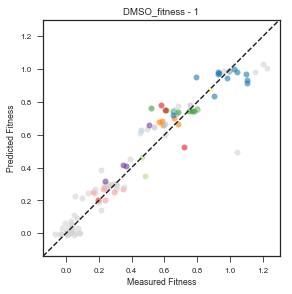

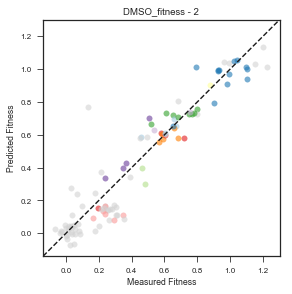

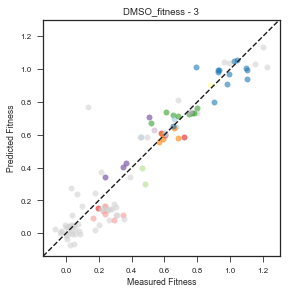

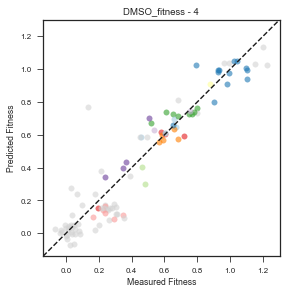

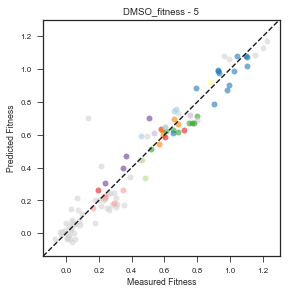

...

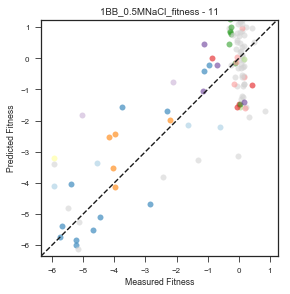

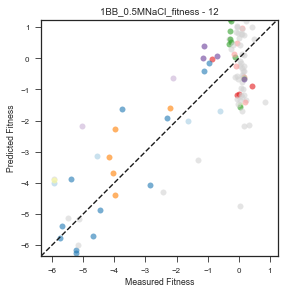

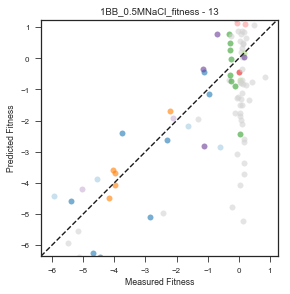

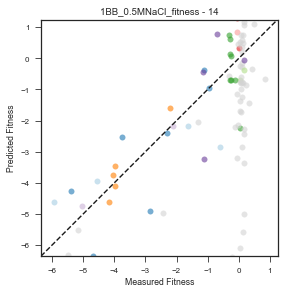

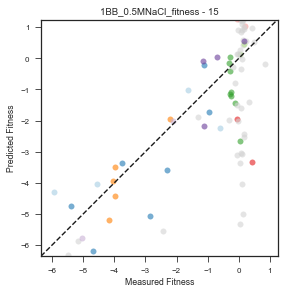

In [42]:
test_mutant_data = this_data[~this_data['barcode'].isin(minimal_training_bcs)]
test_mutant_data = this_data[this_data['barcode'].isin(minimal_testing_bcs)]


# this_gene = ['GPB2','PDE2','IRA1','Diploid']
# this
# this_gene_data = test_mutant_data[test_mutant_data['gene'].isin(this_gene)]

this_gene_data = test_mutant_data

# type_list = ['nonsense_variant','frameshift_variant']
# type_list = ['missense_variant']
# this_gene_data = this_gene_data[this_gene_data['type'].isin(type_list)]
this_gene_locs = range(len(this_gene_data))

# this_gene_locs = np.where(np.isin(test_mutant_data['barcode'].values,this_gene_data['barcode'].values))[0]
jitters = [tools.jitter_point(0,0.01) for bc in range(len(this_gene_data[train_conditions[0]].values)) ]

for i,col in enumerate(test_conditions):
    for rank in range(len(guesses)):
        plt.figure()
        plt.title(f'{col} - {rank+1}')
        for bc in range(len(this_gene_data[col].values)):
#             plt.scatter(this_gene_data[col].values[bc],guesses[rank][this_gene_locs[bc],i],color=mutant_colorset[this_gene_data['gene'].values[bc]],alpha=0.6)
            plt.scatter(this_gene_data[col].values[bc],guesses[rank][this_gene_locs[bc],i],color=mutant_colorset[this_gene_data['gene'].values[bc]],alpha=0.6)


        if rank == 0:
            xmin,xmax = plt.xlim()
            ymin,ymax = plt.ylim()
        plt.xlim(min(xmin,ymin),max(xmax,ymax))
        plt.ylim(min(xmin,ymin),max(xmax,ymax))
        plt.tight_layout()
        plt.plot([min(xmin,ymin),max(xmax,ymax)],[min(xmin,ymin),max(xmax,ymax)],'k--')
        plt.gca().set_aspect('equal')
        plt.xlabel('Measured Fitness')
        plt.ylabel('Predicted Fitness')
#         plt.savefig(f'predictions_by_gene_sidebyside_minimaltraining_{col.replace("/","")}_{rank+1}components_lims.pdf',bbox_inches='tight')

In [43]:

mean_guess = []
for i,col in enumerate(test_cols):

    mean_guess.append(tools.var_explained(this_fitness[test[1],:][:,new_test_locs[i]],
                        np.mean(this_fitness[test[1],:][:,new_train_locs],axis=1))[0])



In [44]:
by_condition.shape

(26, 15)

In [28]:
np.sum((this_fitness[test[1],:][:,new_test_locs[0]]-np.mean(this_fitness[test[1],:][:,new_train_locs],axis=1))**2)

11.985113791854731

In [46]:
from multiprocessing import Pool

In [49]:
%%time
with Pool(10) as pool:
    entries = [[this_fitness,train,test,n_components,True,False,False] for n_components in range(1,15)]
    # (,by_condition=True,by_mutant=False)
    output = pool.starmap(tools.SVD_predictions_train_test_mixnmatch,entries)

CPU times: user 1.71 s, sys: 14.6 s, total: 16.3 s
Wall time: 33.2 s


In [51]:
sort_list = []
guess_list = []
for o in output:
    sort_list.append(sorted([(o1,o2,o3) for o1,o2,o3 in zip(o[0],o[4],o[1])],reverse=True))
    guess_list.append(sorted([(o1,o2) for o1,o2 in zip(o[0],o[-1])],reverse=True))
sorted_rank_combos = sort_list   



In [273]:
sorted_rank_combos

[[(0.5253548361449041,
   [0],
   [0.8979061296877537,
    0.9531308473779522,
    0.8617249516911882,
    0.806387916280381,
    0.7831571468557226,
    0.8255532245617662,
    0.7017877613753185,
    0.8437855872653696,
    0.6575569941766114,
    0.5823542021209469,
    0.5227406230368709,
    0.21446574527070994,
    0.15738831808543863,
    -0.12175718613302444,
    -0.0835528569244488,
    -0.4055434643954907,
    0.05257159272625678,
    -0.022288456522742806,
    0.5012662439145112]),
  (-0.28560439364708,
   [2],
   [-0.8945162056639033,
    -1.0750209613633919,
    -0.8200420857584361,
    -1.6458416036890462,
    -1.2817492271437176,
    -1.2548354906761223,
    -1.2540071506371722,
    -1.4669373165147905,
    -1.355159384391218,
    -2.3580478359962633,
    -0.8586337831236865,
    -0.8049276283674587,
    -0.6210326473135257,
    0.1133618459021527,
    0.16319769917042126,
    -0.2884577707923912,
    -0.11031787095133061,
    0.14031047538651908,
    -0.22177909097073])

(0, 1)

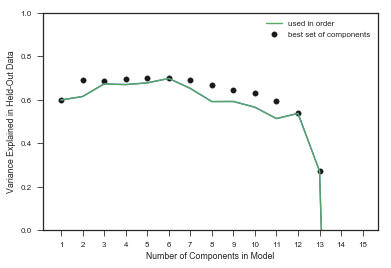

In [52]:
by_rank, by_condition, by_mutant, mean_fits, guesses = tools.SVD_predictions_train_test(this_fitness,train,test,by_condition=True,by_mutant=False)
# by_condition = np.asarray(by_condition).swapaxes(0,1)

condition_colors = sns.color_palette()
plt.plot(by_rank)

for rank in range(len(sorted_rank_combos)):
    plt.scatter(rank,sorted_rank_combos[rank][0][0],color='k',label='best set of components' if rank ==0 else '_nolegend_')
plt.plot(by_rank,label='used in order')
# plt.savefig('predictions_best_per_rank.pdf',bbox_inches='tight')
plt.xticks(range(len(by_rank)),range(1,len(by_rank)+1))
plt.xlabel('Number of Components in Model')
plt.ylabel('Variance Explained in Held-Out Data')
plt.legend()
plt.ylim(0,1)

In [307]:
output

[([0.5253548361449041,
   -0.32484571820090347,
   -0.28560439364708,
   -0.3544784982628686,
   -0.5286809679514886,
   -0.5618578998315935,
   -0.4092927715828174,
   -0.3737066714587569,
   -0.4100100494549548,
   -0.39630017656207905,
   -0.43092536993498,
   -0.4080612518055742,
   -0.46381683368867144,
   -1.0869272525524125,
   -1.9336506524572528],
  [[0.8979061296877537,
    0.9531308473779522,
    0.8617249516911882,
    0.806387916280381,
    0.7831571468557226,
    0.8255532245617662,
    0.7017877613753185,
    0.8437855872653696,
    0.6575569941766114,
    0.5823542021209469,
    0.5227406230368709,
    0.21446574527070994,
    0.15738831808543863,
    -0.12175718613302444,
    -0.0835528569244488,
    -0.4055434643954907,
    0.05257159272625678,
    -0.022288456522742806,
    0.5012662439145112],
   [-0.923149066523655,
    -1.1293582857902074,
    -0.7627189071890628,
    -1.7901508283510146,
    -1.2332539439808103,
    -1.4175125414064702,
    -1.3537961837650925,
 

In [53]:
swapped_by_condition = np.asarray([this_rank[0][2] for this_rank in sorted_rank_combos])

by_rank = [sorted_rank_combos[rank][0][0] for rank in range(len(sorted_rank_combos))]

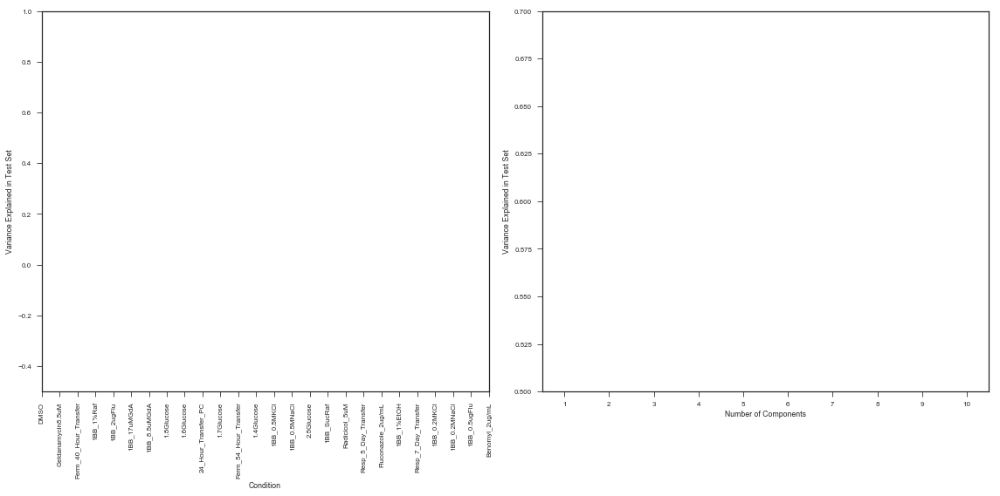

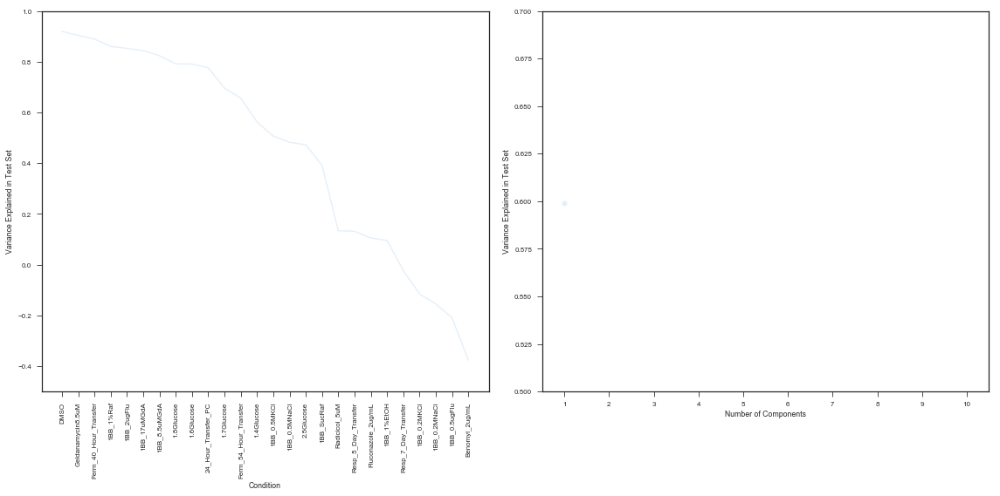

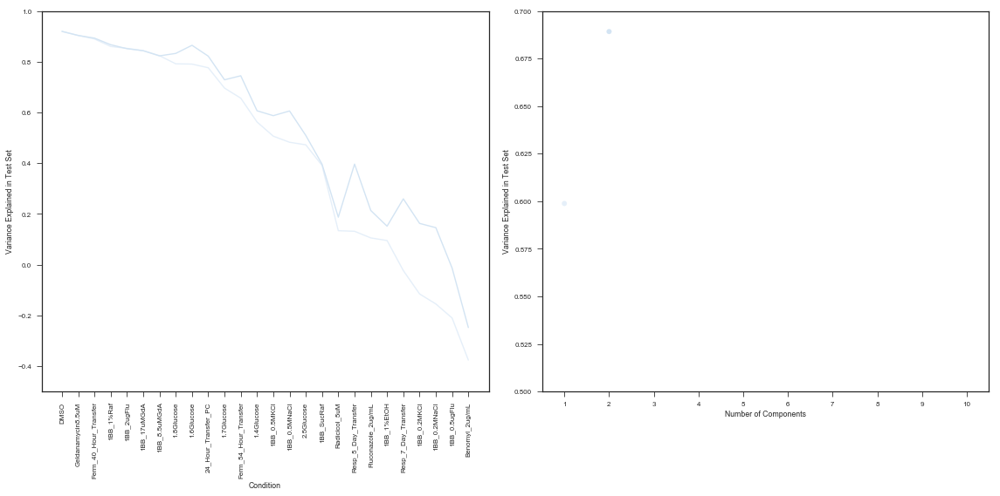

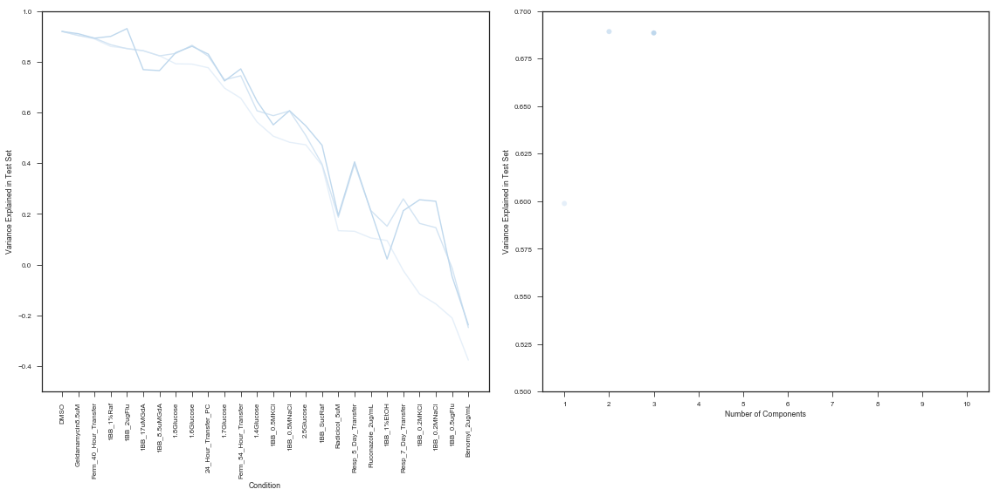

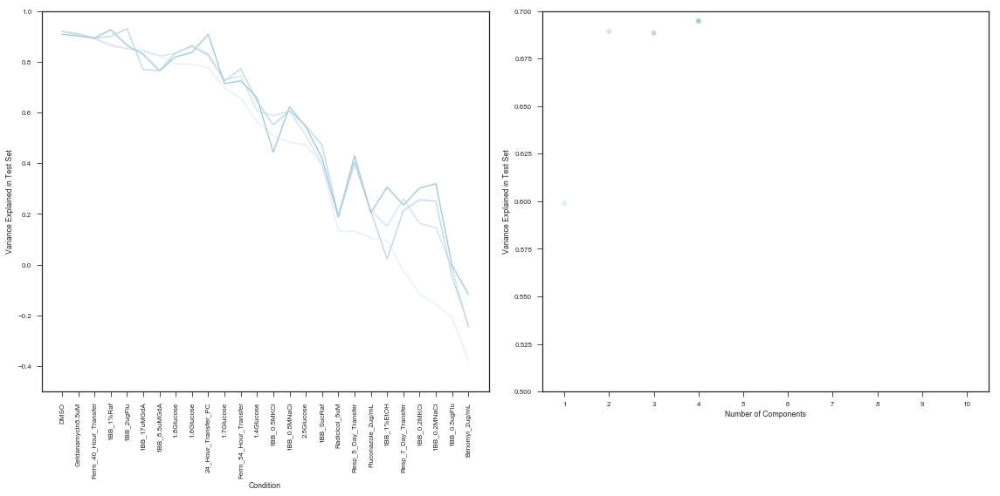

...

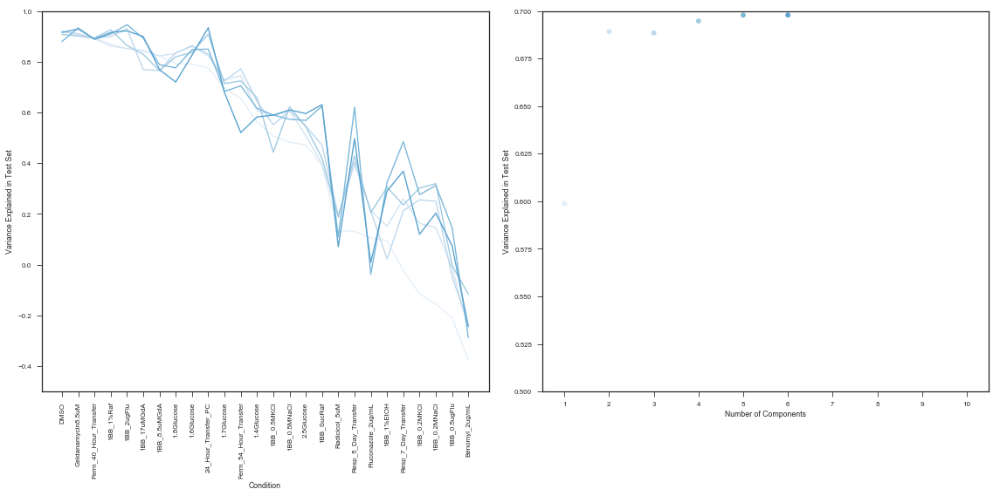

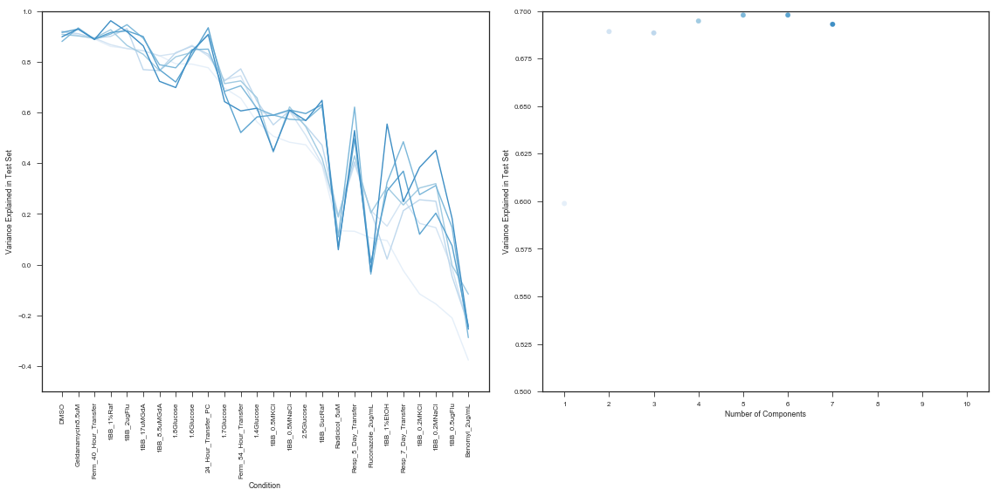

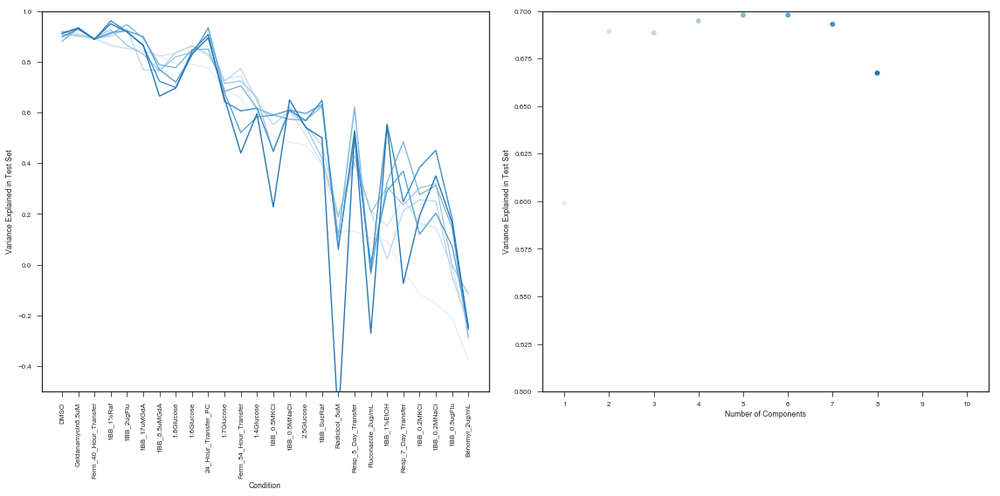

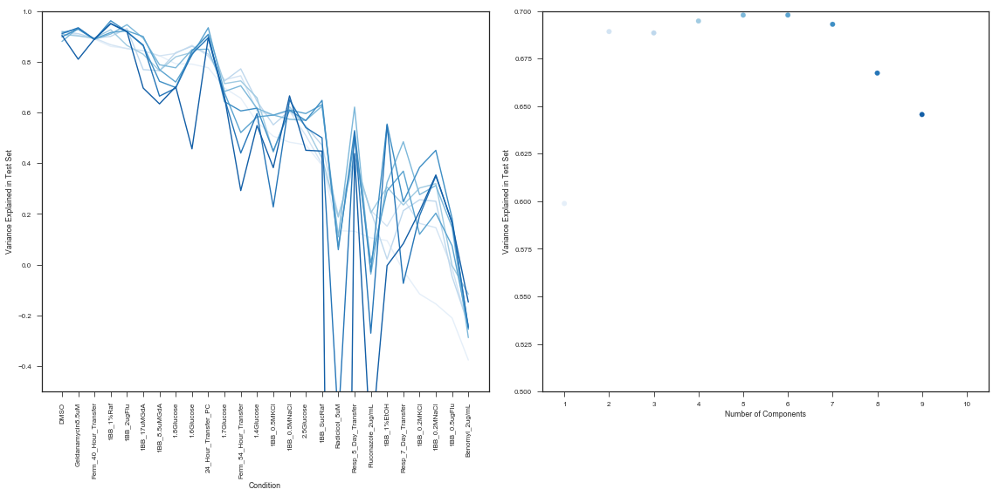

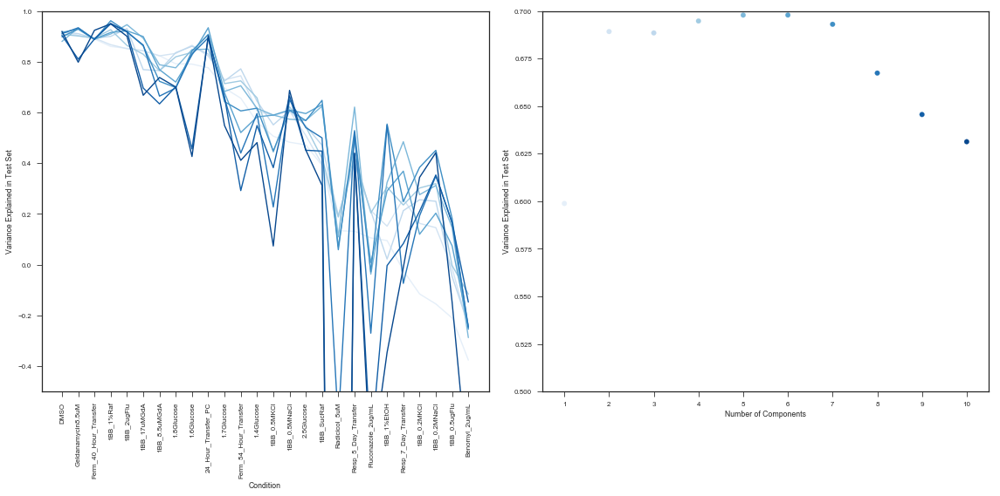

In [54]:
# import matplotlib.pyplot as plt
# import seaborn as sns
# sns.set(style="ticks", context="talk")
# plt.style.use("dark_background")


# swapped_by_condition = by_condition.swapaxes(0,1)
# swapped_by_condtion = np.asarray(swapped_by_condition)
# sorted_by_mean = np.argsort(-np.asarray(mean_guess))
sorted_by_mean = np.argsort(-swapped_by_condition[0])
max_rank = 10

# for rank in range(len(swapped_by_condition)):
for this_rank in range(max_rank+1):
    plt.figure(figsize=(16,8))
    plt.subplot(121)
    
#     plt.plot(np.asarray(mean_guess)[sorted_by_mean],'w--')
    for rank in range(0,this_rank):
        plt.plot(swapped_by_condition[rank][sorted_by_mean],label=rank+1,color=sns.color_palette('Blues',max_rank)[rank])
    plt.ylim(-0.5,1)
#     plt.ylim(0,1)
    # plt.plot(np.asarray(mean_guess)[sorted_by_mean],'k--')
#     plt.legend()
    plt.xticks([i for i in range(len(test_cols))],[col.split('_fitness')[0] for col in np.asarray(test_cols)[sorted_by_mean]],rotation=90)
    plt.ylabel('Variance Explained in Test Set')
    plt.xlabel('Condition')
    
    plt.subplot(122)
    if this_rank > 0:
        plt.scatter(range(0,this_rank),[by_rank[rank] for rank in range(0,this_rank)],color=[sns.color_palette('Blues',max_rank)[rank] for rank in range(this_rank)])
    plt.xlim(-0.5,max_rank-0.5)
    plt.ylabel('Variance Explained in Test Set')
    plt.xlabel('Number of Components')
    plt.xticks(range(max_rank),[i+1 for i in range(max_rank)])
    plt.ylim(0.5,0.7)
    
    plt.tight_layout()
    plt.savefig(f'predictions_mixnmatch_by_condition_rank{this_rank}.pdf',bbox_inches='tight')

IndexError: list index out of range

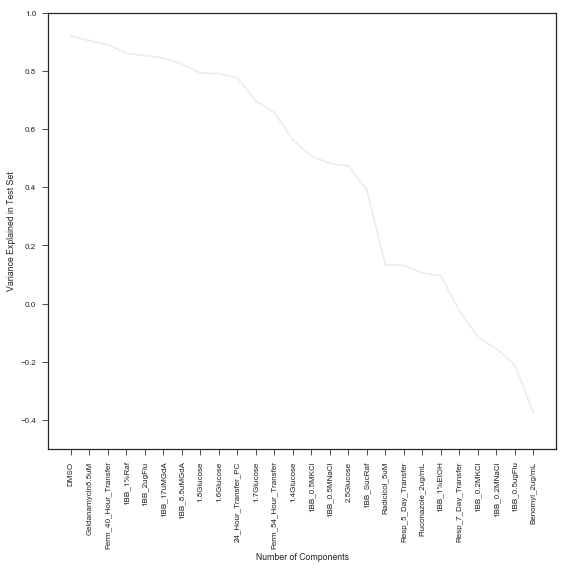

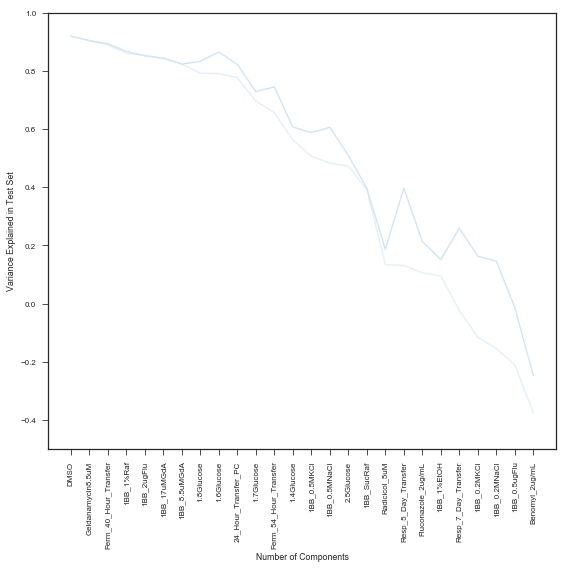

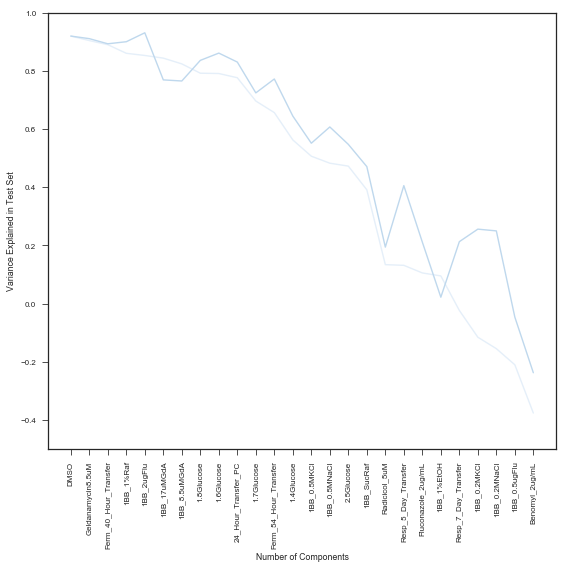

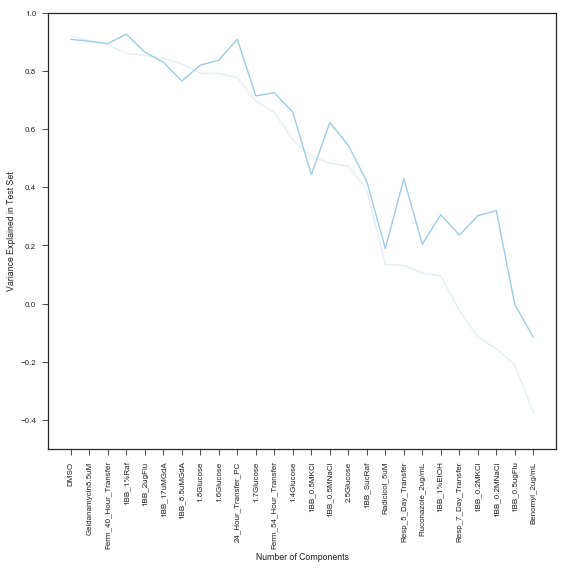

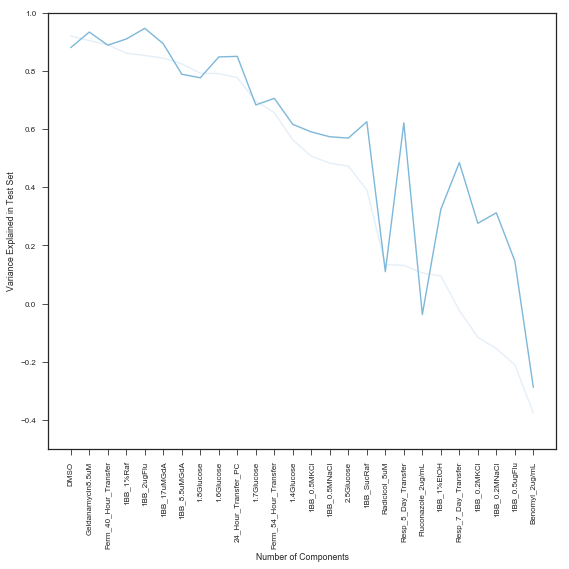

...

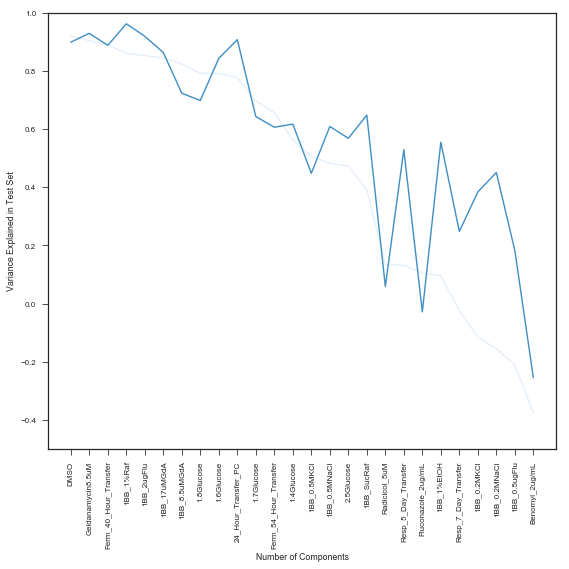

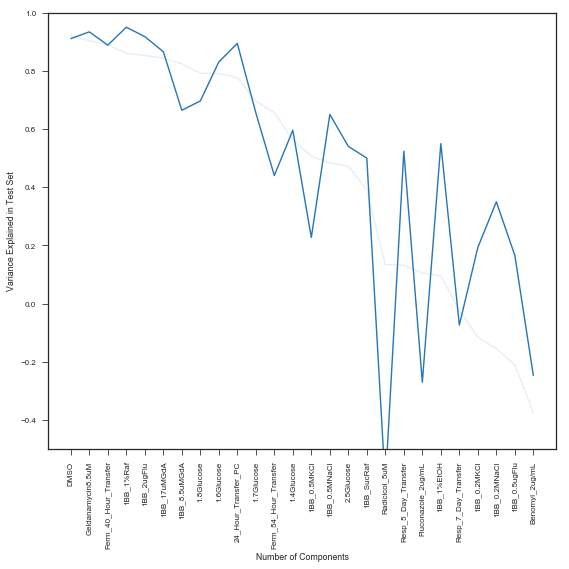

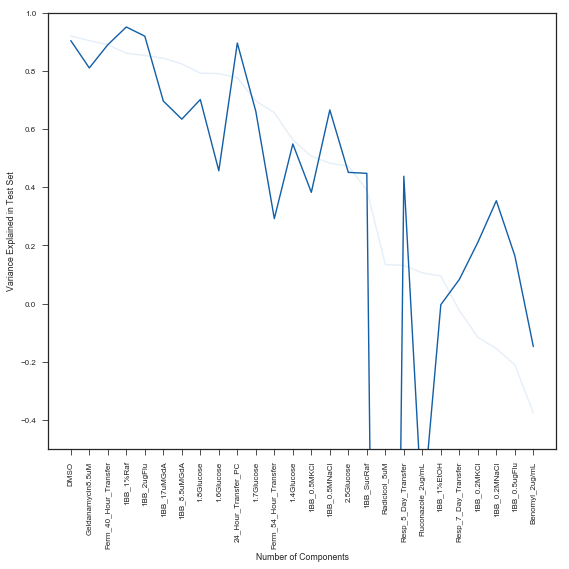

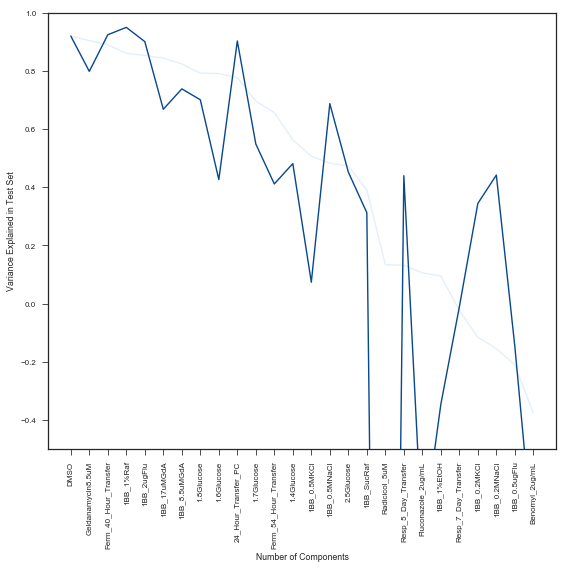

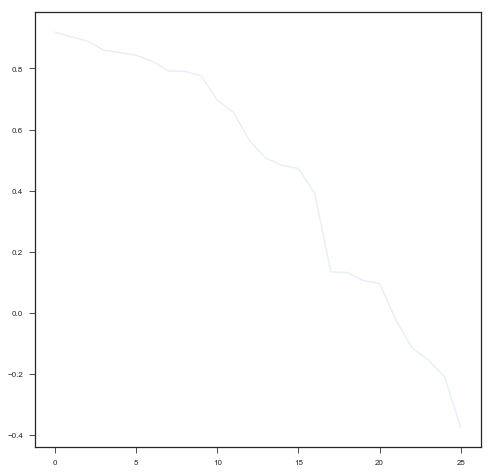

In [55]:
# sns.set(style="ticks", context="talk")
# plt.style.use("dark_background")


# swapped_by_condition = by_condition.swapaxes(0,1)
# swapped_by_condtion = np.asarray(swapped_by_condition)
# sorted_by_mean = np.argsort(-np.asarray(mean_guess))
sorted_by_mean = np.argsort(-swapped_by_condition[0])
max_rank = 10

# for rank in range(len(swapped_by_condition)):
for this_rank in range(max_rank+1):
    plt.figure(figsize=(8,8))
#     plt.subplot(121)
    
#     plt.plot(np.asarray(mean_guess)[sorted_by_mean],'w--')
    for rank in [0,this_rank]:
        plt.plot(swapped_by_condition[rank][sorted_by_mean],label=rank+1,color=sns.color_palette('Blues',max_rank)[rank])
    plt.ylim(-0.5,1)
#     plt.ylim(0,1)
    # plt.plot(np.asarray(mean_guess)[sorted_by_mean],'k--')
#     plt.legend()
    plt.xticks([i for i in range(len(test_cols))],[col.split('_fitness')[0] for col in np.asarray(test_cols)[sorted_by_mean]],rotation=90)
    plt.ylabel('Variance Explained in Test Set')
    plt.xlabel('Number of Components')
    
#     plt.subplot(122)
#     if this_rank > 0:
#         plt.scatter(range(0,this_rank),[by_rank[rank] for rank in range(0,this_rank)],color=[sns.color_palette('Blues',max_rank)[rank] for rank in range(this_rank)])
#     plt.xlim(-0.5,max_rank-0.5)
#     plt.ylabel('Variance Explained in Test Set')
#     plt.xticks(range(max_rank),[i+1 for i in range(max_rank)])
#     plt.ylim(0.5,0.7)
    
    plt.tight_layout()
    plt.savefig(f'predictions_mixnmatch_by_condition_justrank{this_rank+1}and1.pdf',bbox_inches='tight')

In [314]:
guess_list[0][0][1]

array([[ 0.23781537,  0.33623387,  0.23493938, ...,  0.08053989,
         0.02204364, -0.33410282],
       [ 0.77784043,  1.09974514,  0.76843372, ...,  0.2634278 ,
         0.07209977, -1.09277494],
       [ 0.71242881,  1.00726331,  0.70381315, ...,  0.24127513,
         0.06603662, -1.00087927],
       ...,
       [ 0.29921404,  0.42304202,  0.29559554, ...,  0.1013335 ,
         0.02773482, -0.42036078],
       [ 0.09041443,  0.12783192,  0.08932102, ...,  0.03062026,
         0.00838072, -0.12702172],
       [ 0.01574378,  0.02225924,  0.01555338, ...,  0.00533188,
         0.00145933, -0.02211817]])

In [56]:
mutant_colorset['other'] = 'gray'
mutant_colorset['NotSequenced'] = 'gray'

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


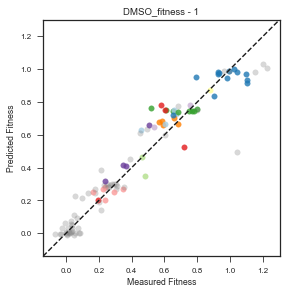

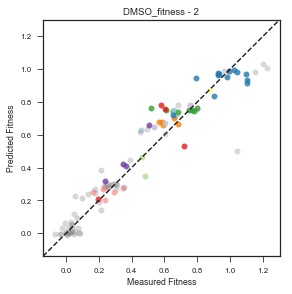

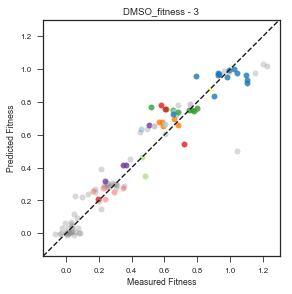

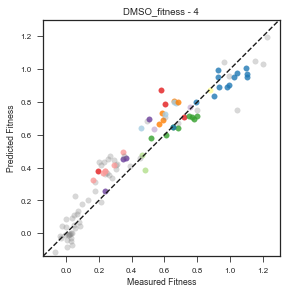

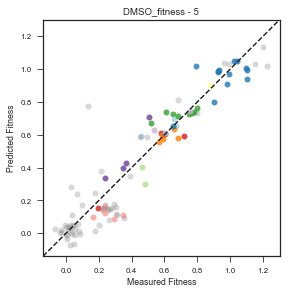

...

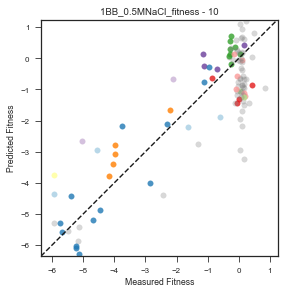

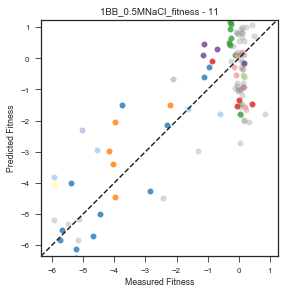

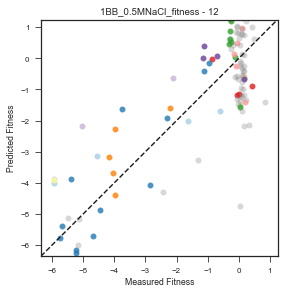

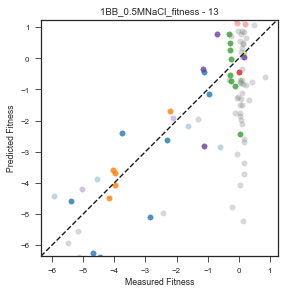

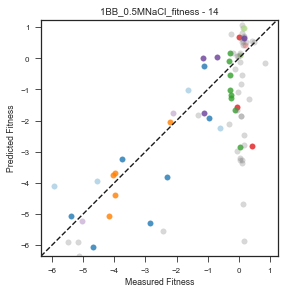

In [57]:
test_mutant_data = this_data[~this_data['barcode'].isin(minimal_training_bcs)]
test_mutant_data = this_data[this_data['barcode'].isin(minimal_testing_bcs)]


# this_gene = ['GPB2','PDE2','IRA1','Diploid']
# this
# this_gene_data = test_mutant_data[test_mutant_data['gene'].isin(this_gene)]

this_gene_data = test_mutant_data

# type_list = ['nonsense_variant','frameshift_variant']
# type_list = ['missense_variant']
# this_gene_data = this_gene_data[this_gene_data['type'].isin(type_list)]
this_gene_locs = range(len(this_gene_data))

# this_gene_locs = np.where(np.isin(test_mutant_data['barcode'].values,this_gene_data['barcode'].values))[0]
jitters = [tools.jitter_point(0,0.01) for bc in range(len(this_gene_data[train_conditions[0]].values)) ]

for i,col in enumerate(test_conditions):
    for rank in range(len(guess_list)):
        plt.figure()
        plt.title(f'{col} - {rank+1}')
        for bc in range(len(this_gene_data[col].values)):
            if (this_gene_data['gene'].values[bc] == 'NotSequenced') or (this_gene_data['gene'].values[bc] == 'other'):
                plt.scatter(this_gene_data[col].values[bc],guess_list[rank][0][1][this_gene_locs[bc],i],color=mutant_colorset[this_gene_data['gene'].values[bc]],alpha=0.3)

            else:
#             plt.scatter(this_gene_data[col].values[bc],guesses[rank][this_gene_locs[bc],i],color=mutant_colorset[this_gene_data['gene'].values[bc]],alpha=0.6)
                plt.scatter(this_gene_data[col].values[bc],guess_list[rank][0][1][this_gene_locs[bc],i],color=mutant_colorset[this_gene_data['gene'].values[bc]],alpha=0.8)


        if rank == 0:
            xmin,xmax = plt.xlim()
            ymin,ymax = plt.ylim()
        plt.xlim(min(xmin,ymin),max(xmax,ymax))
        plt.ylim(min(xmin,ymin),max(xmax,ymax))
        plt.tight_layout()
        plt.plot([min(xmin,ymin),max(xmax,ymax)],[min(xmin,ymin),max(xmax,ymax)],'k--')
        plt.gca().set_aspect('equal')
        plt.xlabel('Measured Fitness')
        plt.ylabel('Predicted Fitness')
        plt.savefig(f'predictions_by_gene_mixnmatch_sidebyside_minimaltraining_light_{col.replace("/","")}_{rank+1}components_lims.pdf',bbox_inches='tight')

In [61]:
sorted_rank_combos[5][0][1]

[0, 1, 2, 3, 4, 5]

In [117]:

component_set = sorted_rank_combos[5][0][1]


train_mut, test_mut, train_con, test_con = tools.SVD_mixnmatch_locations(this_fitness,train,test,component_set,by_condition=True,by_mutant=False)

0.697840564035643


In [97]:
test_mut

array([[-8.62217768e-02,  5.96872081e-01,  3.73123390e-02,
        -1.21026915e-01, -2.43989980e-01,  4.74904787e-01],
       [-2.90451997e-01,  1.01745887e-01,  3.30659759e-01,
         4.26045973e-02,  6.26981590e-02,  1.03049110e-01],
       [-2.70281607e-01, -8.00327333e-02,  2.88431535e-01,
        -2.30569662e-01,  4.19283755e-01,  8.25010924e-02],
       [-9.67303031e-02,  2.86165209e-01, -7.23484298e-02,
        -3.25541288e-01, -2.68751060e-01,  5.87556781e-02],
       [-3.58092982e-01, -2.75945259e-01, -4.35690483e-02,
         3.48733591e-02,  3.94735630e-02,  3.50638004e-01],
       [-3.44958413e-01, -1.40236800e-01, -2.96916884e-01,
         3.03970203e-01, -2.02061729e-01, -2.12538644e-03],
       [-1.83892689e-01, -1.38608751e-01,  4.14999349e-01,
        -1.00254385e+00, -1.79543100e-01,  5.01017026e-01],
       [-2.51911484e-01,  1.87435581e-01, -2.12641412e-01,
         1.76714759e-02, -5.47216359e-01, -2.94818497e-01],
       [-1.61315220e-01,  1.69000307e-01,  1.256

In [80]:
train_con.shape

(6, 15)

In [101]:
train

test

[array([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31,
        32, 33, 34, 35, 36, 37, 38, 39, 40]),
 array([  1,   2,   3,   5,   6,   7,   8,   9,  10,  11,  12,  13,  14,
         15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  26,  27,  28,
         29,  30,  31,  32,  35,  36,  37,  38,  40,  41,  42,  43,  44,
         46,  47,  50,  51,  52,  53,  54,  55,  56,  57,  58,  59,  60,
         61,  62,  64,  66,  67,  68,  69,  70,  71,  72,  73,  75,  76,
         77,  78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,
         90,  91,  92,  93,  94,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 117,
        118, 120, 121])]

In [99]:
this_data['gene'].values[test_locs]

array(['IRA2', 'GPB1', 'GPB2', 'Diploid', 'Diploid', 'Diploid + IRA2',
       'IRA1', 'NotSequenced', 'Diploid', 'Diploid', 'Diploid', 'IRA1',
       'Diploid + IRA2', 'PDE2', 'PDE2', 'Diploid + Chr11Amp', 'IRA2',
       'NotSequenced', 'Diploid', 'GPB2', 'GPB2', 'IRA1', 'other', 'IRA1',
       'PDE2', 'CYR1'], dtype=object)

In [111]:
np.argsort(np.concatenate((train[1],test[1])))

array([  0,  15,  16,  17,   1,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,   2,
        38,  39,  40,  41,  42,  43,  44,   3,   4,  45,  46,  47,  48,
         5,  49,  50,  51,  52,  53,   6,  54,  55,   7,   8,  56,  57,
        58,  59,  60,  61,  62,  63,  64,  65,  66,  67,  68,   9,  69,
        10,  70,  71,  72,  73,  74,  75,  76,  77,  11,  78,  79,  80,
        81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,  92,  93,
        94,  95,  96,  97,  12,  98,  99, 100, 101, 102, 103, 104, 105,
       106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,  13,
       118, 119,  14, 120, 121])

In [112]:
all_mutants

array([[-3.77238837e-01, -4.28514061e-01, -9.97973615e-02,
         2.58012452e-01,  2.54855096e-01, -2.89545794e-01],
       [-3.48244653e-01,  2.21959519e-02, -3.79832591e-01,
         3.44070224e-01, -2.14605812e-01,  1.71782731e-01],
       [-2.28515727e-01,  7.31184280e-02,  1.41972934e-01,
        -1.62941050e-01,  3.84454514e-02,  2.11760350e-01],
       [-3.36961651e-01, -6.10029864e-02, -2.56777099e-01,
        -1.75153829e-02, -2.58765512e-01,  5.30380503e-01],
       [-2.59905343e-01,  1.55176412e-02,  3.21398238e-01,
        -1.81326079e-01,  4.39582163e-01,  1.80817458e-01],
       [-1.98250583e-01,  2.58161961e-01,  2.34740026e-01,
         2.40032158e-01, -1.16779296e-01, -6.90978401e-02],
       [-2.99358012e-01, -6.12314880e-01,  2.03461554e-01,
        -2.96610774e-01, -3.36109226e-01, -2.68148476e-03],
       [-3.02473614e-01,  8.57383729e-02, -9.93015961e-02,
        -2.07031720e-03,  2.26006470e-01, -1.97439697e-01],
       [-2.42368363e-01,  3.11171943e-01, -8.341

In [113]:
all_mutants[np.argsort(np.concatenate((train[1],test[1]))),:]

array([[-3.77238837e-01, -4.28514061e-01, -9.97973615e-02,
         2.58012452e-01,  2.54855096e-01, -2.89545794e-01],
       [-8.62217768e-02,  5.96872081e-01,  3.73123390e-02,
        -1.21026915e-01, -2.43989980e-01,  4.74904787e-01],
       [-2.90451997e-01,  1.01745887e-01,  3.30659759e-01,
         4.26045973e-02,  6.26981590e-02,  1.03049110e-01],
       [-2.70281607e-01, -8.00327333e-02,  2.88431535e-01,
        -2.30569662e-01,  4.19283755e-01,  8.25010924e-02],
       [-3.48244653e-01,  2.21959519e-02, -3.79832591e-01,
         3.44070224e-01, -2.14605812e-01,  1.71782731e-01],
       [-9.67303031e-02,  2.86165209e-01, -7.23484298e-02,
        -3.25541288e-01, -2.68751060e-01,  5.87556781e-02],
       [-3.58092982e-01, -2.75945259e-01, -4.35690483e-02,
         3.48733591e-02,  3.94735630e-02,  3.50638004e-01],
       [-3.44958413e-01, -1.40236800e-01, -2.96916884e-01,
         3.03970203e-01, -2.02061729e-01, -2.12538644e-03],
       [-1.83892689e-01, -1.38608751e-01,  4.149

In [124]:
this_data[this_data.index.isin(train[1])]

,13.1_error,13.1_fitness,13.2_error,13.2_fitness,13.3_error,13.3_fitness,18.1_error,18.1_fitness,18.2_error,18.2_fitness,...,Fluconazole_2ug/mL_fitness,Geldanamycin8.5uM_fitness,M3_Batch_13_fitness,M3_Batch_18_fitness,M3_Batch_19_allpool_fitness,M3_Batch_3_fitness,M3_Batch_6_PC_fitness,Radicicol_5uM_fitness,Resp_5_Day_Transfer_fitness,Resp_7_Day_Transfer_fitness
0,0.57735,0.308703,0.57735,0.325434,0.57735,0.231772,0.57735,0.408306,0.57735,0.417528,...,0.400967,0.356138,0.367350,0.328750,0.319338,0.316519,0.332239,-0.090556,0.559755,0.516161
4,0.57735,1.131856,0.57735,1.123449,0.57735,0.857542,0.57735,0.822756,0.57735,0.969978,...,0.267642,0.792930,0.383720,0.858641,0.926400,0.706600,0.993168,0.614618,1.443056,0.809331
25,0.57735,1.063149,0.57735,1.100677,0.57735,0.952811,0.57735,0.941637,0.57735,1.052741,...,0.012325,0.615879,0.374383,0.948102,0.987840,0.632378,0.917859,0.375996,1.123444,0.679070
33,0.57735,0.858975,0.57735,0.896750,0.57735,0.476360,0.57735,0.777224,0.57735,0.788441,...,0.406317,0.668473,0.452463,0.711994,0.633728,0.736181,0.798551,1.013870,1.091292,0.600318
45,0.57735,1.092755,0.57735,1.113438,0.57735,0.907682,0.57735,0.803355,0.57735,0.966212,...,1.172853,0.649384,0.411020,0.834388,0.957939,0.575884,0.877786,0.752260,1.170938,0.645433
48,0.57735,0.903404,0.57735,0.940099,0.57735,0.618542,0.57735,0.772453,0.57735,0.813098,...,0.491907,0.644693,0.588863,0.732787,0.752408,0.696187,0.800028,0.497273,0.984403,0.387535
49,0.57735,0.265316,0.57735,0.305183,0.57735,0.261301,0.57735,0.465758,0.57735,0.472842,...,-0.196428,0.340474,0.303162,0.311248,0.326570,0.201564,0.164348,0.195467,0.474797,0.617573
63,0.57735,1.037604,0.57735,1.060320,0.57735,0.810582,0.57735,0.783459,0.57735,0.922123,...,0.320210,0.764434,0.429712,0.792723,0.892442,0.660609,0.949680,0.500070,1.202706,0.657372
74,0.57735,0.361676,0.57735,0.338451,0.57735,0.217761,0.57735,0.346253,0.57735,0.335853,...,0.115001,0.438885,0.211303,0.386219,0.329373,0.383600,0.466791,0.867518,0.434449,0.059978
95,0.57735,1.169238,0.57735,1.143384,0.57735,0.929473,0.57735,0.910660,0.57735,1.020255,...,0.261897,0.781875,0.570889,0.935035,0.999659,0.891448,1.076654,0.214642,1.242171,0.788469


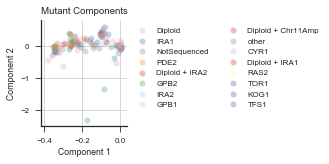

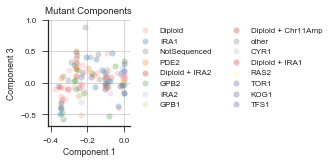

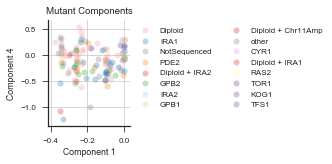

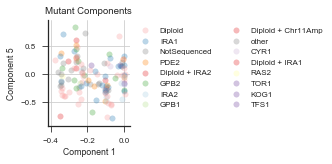

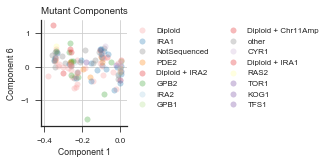

...

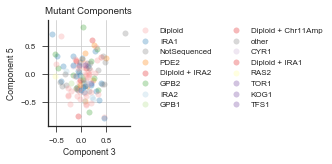

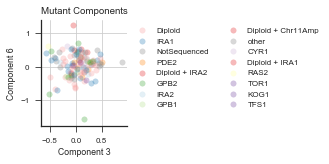

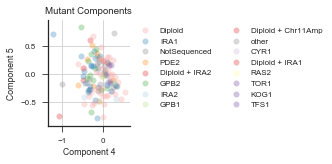

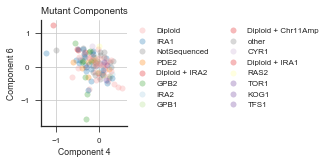

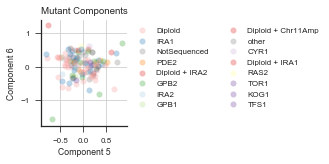

In [126]:
all_mutants = np.concatenate((train_mut,test_mut[:,:6]),axis=0)
all_mutants = all_mutants[np.argsort(np.concatenate((train[1],test[1]))),:]

# all_mutants=  train_mut

all_conditions = np.concatenate((train_con,test_con[:,:6]),axis=0)

# these_genes = list(this_data['gene'].values[train[1]]) + list(this_data['gene'].values[test[1]])

# mutant_colors = [mutant_colorset[gene] for gene in these_genes]
mutant_colors = [mutant_colorset[gene] for gene in this_data['gene'].values]

mutant_colors = [mutant_colorset[gene] for gene in this_data['gene'].values]
# mutant_colors = np.asarray(mutant_colors)[train[1]]

# these_conditions = 
# condition_colors = [sns.color_palette()[i%len(sns.color_palette())] for i in range(len(all_conditions))]

for x,y in combinations(range(6),2):
    
    plt.figure()
    ax = plt.subplot(2,2,1)
    tools.plot_mutant_components(ax,all_mutants,this_data,x,y,mutant_colors)
    
#     ax = plt.subplot(2,2,2)
#     tools.plot_mutant_components(ax,all_conditions,this_data,x,y,condition_colors)
    
#     plt.title('Condition Components')
    
    plt.tight_layout()
    plt.savefig(f'space_plotted_{x}_{y}.pdf',bbox_inches='tight')
    
#     ax = plt.subplot(2,2,3)
    
#     ax = plt.subplot(2,2,4)
    
    

In [239]:
gene_locs = {}

altered_data=copy.copy(this_data)

new_genes = []
for bc in range(len(this_data['barcode'].values)):
    gene = this_data['gene'].values[bc]
    print(gene,len(this_data[this_data['gene']==gene].values))
    if len(this_data[this_data['gene']==gene].values) < 4:
        new_genes.append('other')
    else:
        new_genes.append(gene)

altered_data['gene'] = new_genes

for gene in np.unique(altered_data['gene'].values):
    this_gene = np.where(np.isin(altered_data['barcode'].values,altered_data[altered_data['gene']==gene]['barcode'].values))[0]
    gene_locs[gene] = np.where(np.isin(test[1],this_gene))[0]

Diploid 139
IRA1 25
NotSequenced 32
IRA1 25
NotSequenced 32
IRA1 25
NotSequenced 32
NotSequenced 32
NotSequenced 32
Diploid 139
PDE2 11
other 51
other 51
PDE2 11
Diploid 139
Diploid + IRA2 3
GPB2 13
IRA2 7
GPB1 4
GPB2 13
Diploid 139
Diploid 139
Diploid + IRA2 3
IRA1 25
NotSequenced 32
Diploid 139
Diploid 139
Diploid 139
Diploid 139
IRA1 25
Diploid + IRA2 3
PDE2 11
PDE2 11
Diploid + Chr11Amp 2
IRA2 7
NotSequenced 32
Diploid 139
other 51
Diploid 139
GPB2 13
GPB2 13
IRA1 25
other 51
IRA1 25
PDE2 11
CYR1 3
Diploid 139
other 51
NotSequenced 32
Diploid 139
Diploid 139
IRA1 25
GPB2 13
Diploid + IRA1 1
other 51
Diploid 139
GPB2 13
RAS2 1
IRA1 25
GPB2 13
Diploid 139
Diploid 139
Diploid 139
IRA1 25
other 51
Diploid 139
Diploid 139
GPB2 13
NotSequenced 32
Diploid 139
Diploid 139
IRA1 25
IRA1 25
Diploid 139
PDE2 11
NotSequenced 32
other 51
GPB2 13
other 51
IRA2 7
Diploid 139
IRA1 25
NotSequenced 32
PDE2 11
IRA1 25
Diploid 139
Diploid 139
Diploid 139
other 51
other 51
IRA1 25
PDE2 11
TOR1 1
Diploid

In [159]:
gene_locs

{'Diploid': array([  7,  12,  18,  19,  23,  24,  25,  33,  40,  43,  46,  51,  52,
         53,  56,  57,  60,  63,  69,  73,  74,  75,  81,  84,  86,  87,
         91,  94,  96,  97, 100, 102, 104, 107, 110, 111, 112, 117, 118,
        119, 124, 127, 129, 130, 131, 132]),
 'GPB1': array([ 16, 115]),
 'GPB2': array([ 14,  17,  34,  35,  47,  50,  58,  66,  88, 108]),
 'IRA1': array([  0,   2,   3,  21,  26,  36,  37,  44,  49,  54,  61,  62,  70,
         78,  83,  89,  93,  98, 101, 103, 116, 122]),
 'IRA2': array([ 15,  31,  68,  82,  92, 106]),
 'NotSequenced': array([  1,   4,   5,   6,  22,  32,  42,  59,  71,  85,  99, 105, 113,
        125]),
 'PDE2': array([ 8, 11, 28, 29, 38, 64, 72, 79]),
 'other': array([  9,  10,  13,  20,  27,  30,  39,  41,  45,  48,  55,  65,  67,
         76,  77,  80,  90,  95, 109, 114, 120, 121, 123, 126, 128])}

In [160]:
cutoff = 10

test_measured = this_fitness[test[1],:][:,test[0]]

devs = np.abs((guesses[0]-test_measured)/test_measured)
devs[devs > cutoff] = np.nan

mean_gene = []
for gene in gene_locs:
    mean_gene.append((np.nanmean(np.nanmean(devs,axis=1)[gene_locs[gene]]),gene))
sorted_mean_gene = sorted(mean_gene)

In [161]:
mutant_sort = []
gene_names = []
for val,gene in sorted_mean_gene:
    gene_names.append((gene,len(gene_locs[gene])))
    mutant_sort.append(gene_locs[gene][np.argsort(np.nanmean(devs,axis=1)[gene_locs[gene]])])
mutant_sort = tools.flatten(mutant_sort)    

In [162]:
by_condition

array([[ 8.97906130e-01,  9.21081338e-01,  9.20292716e-01,
         9.28481549e-01,  9.27367645e-01,  9.30359841e-01,
         9.31420437e-01,  9.31302415e-01,  9.31375062e-01,
         9.31885759e-01,  9.32925713e-01,  9.32898096e-01,
         9.04251246e-01,  1.83271359e-01,  1.13600943e-01],
       [ 9.53130847e-01,  9.76097360e-01,  9.79813332e-01,
         9.76964962e-01,  9.76701591e-01,  9.76295053e-01,
         9.73940527e-01,  9.73260504e-01,  9.69977291e-01,
         9.65042576e-01,  9.67992043e-01,  9.72840451e-01,
         9.74025168e-01,  9.54204985e-01,  9.51392494e-01],
       [ 8.61724952e-01,  8.39612821e-01,  8.72979082e-01,
         8.91932220e-01,  9.01773845e-01,  9.25790997e-01,
         9.09484127e-01,  9.28817917e-01,  9.31093704e-01,
         9.30594044e-01,  9.31720357e-01,  9.34733807e-01,
         9.47919441e-01,  9.26759583e-01,  9.17643236e-01],
       [ 8.06387916e-01,  7.84744914e-01,  8.19909270e-01,
         8.29414710e-01,  7.70051703e-01,  7.30909940

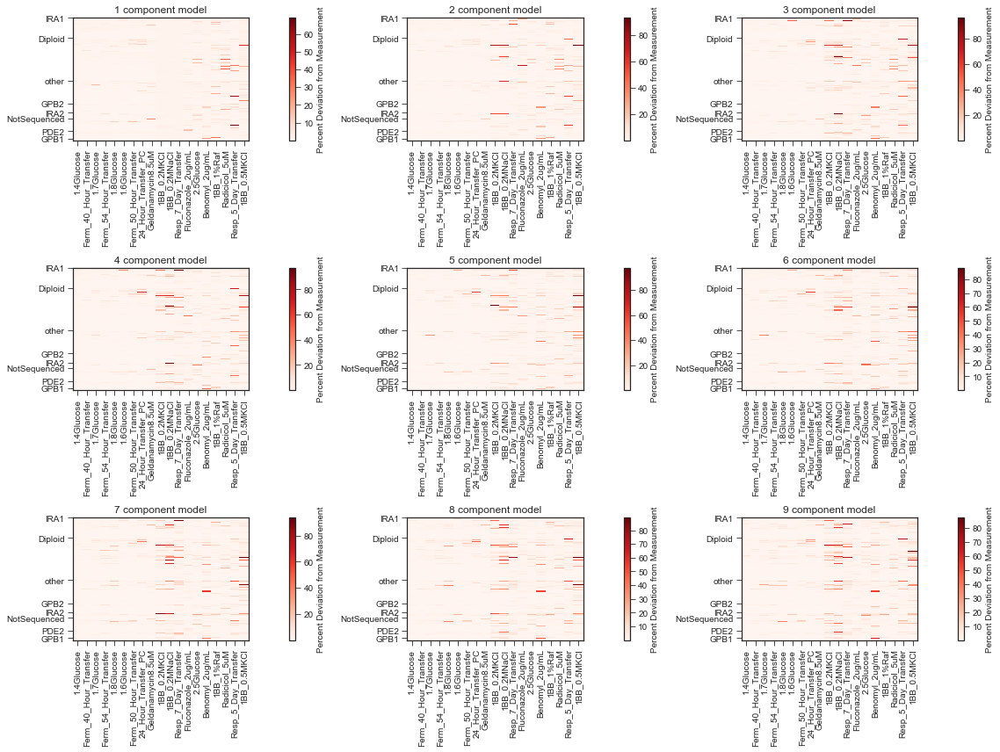

In [167]:
cutoff = 100

test_measured = this_fitness[test[1],:][:,test[0]]

devs = np.abs((guesses[0]-test_measured)/test_measured)
devs[devs > cutoff] = np.nan

# mutant_sort = np.argsort(np.nanmean(devs,axis=1))
condition_sort = np.argsort(np.nanmean(devs,axis=0))


fig = plt.figure(figsize=(4*4,4*3))
for rank in range(9):

    devs = np.abs((guesses[rank]-test_measured)/test_measured)
    devs[devs > cutoff] = np.nan
    
    
    
    sorted_devs = devs[mutant_sort,:][:,condition_sort]


    plt.subplot(3,3,rank+1)
    plt.title(f'{rank+1} component model')
    pcm = plt.pcolormesh(sorted_devs,cmap='Reds')
    cbar = fig.colorbar(pcm,pad=0.16)
    cbar.set_label('Percent Deviation from Measurement')
    
    plt.xticks([i+0.5 for i in range(len(test_cols))],[col.split('_fitness')[0] for col in np.asarray(test_cols)[condition_sort]],rotation=90)
    
    plt.yticks(np.cumsum([i for (g,i) in gene_names]),[g for (g,i) in gene_names])
    
plt.tight_layout()
# plt.savefig(f'prediction_heatmap_allranks_cutoff{cutoff}_witholddat_minimaltraining.pdf',bbox_inches='tight')
                                                           

([<matplotlib.axis.XTick at 0x1524eca58>,
 <a list of 19 Text xticklabel objects>)

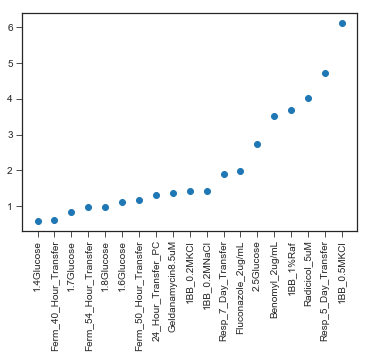

In [168]:
plt.plot(sorted(np.nanmean(devs,axis=0)),'o')
plt.xticks([i for i in range(len(test_cols))],[col.split('_fitness')[0] for col in np.asarray(test_cols)[condition_sort]],rotation=90)



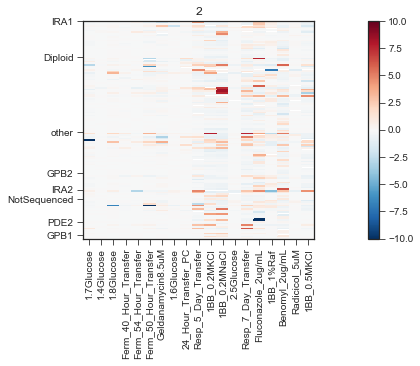

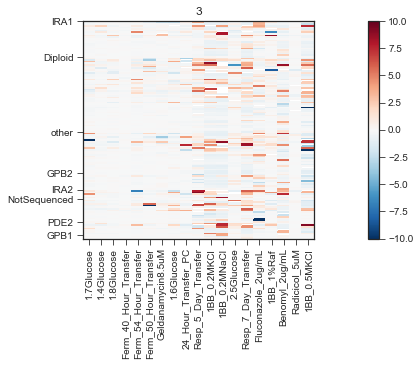

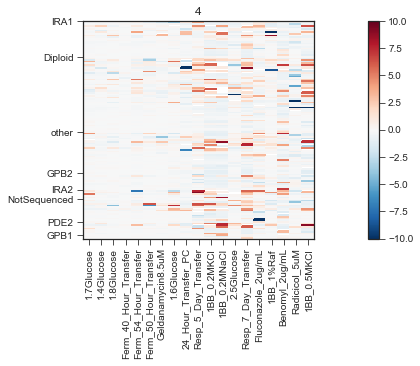

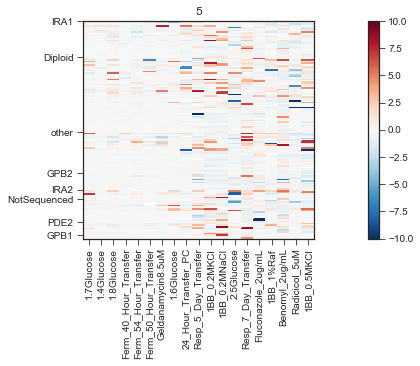

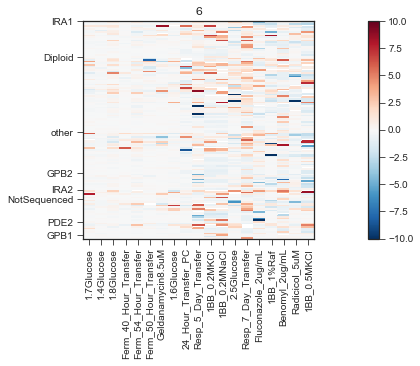

...

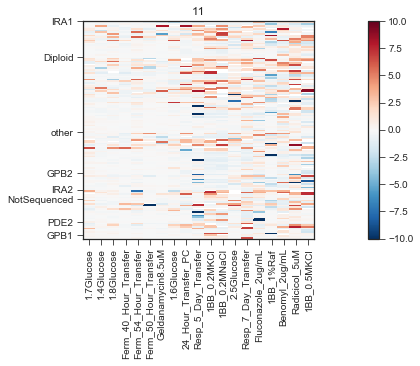

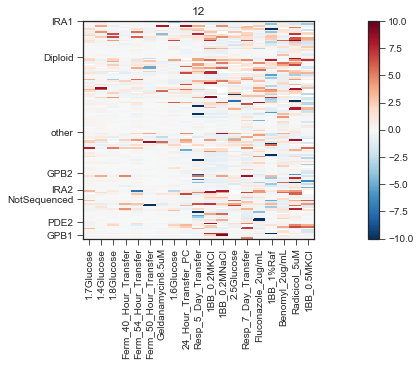

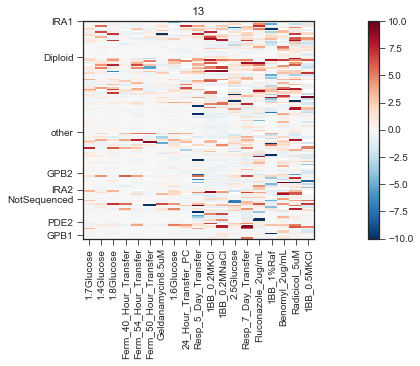

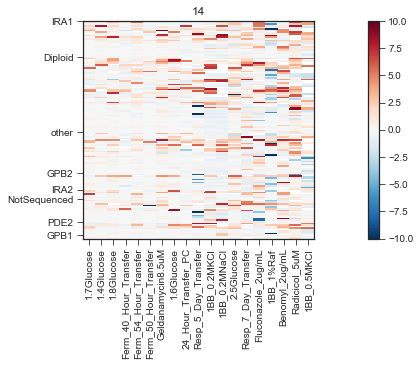

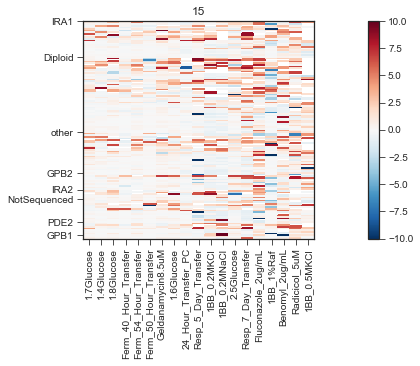

In [169]:
cutoff = 10

test_measured = this_fitness[test[1],:][:,test[0]]

devs0 = np.abs((guesses[0]-test_measured)/test_measured)
devs0[devs0 > cutoff] = np.nan

# mutant_sort = np.argsort(np.nanmean(devs,axis=1))
condition_sort = np.argsort(np.nanmean(devs0,axis=0))

for rank in range(1,len(guesses)):

    devs = np.abs((guesses[rank]-test_measured)/test_measured)
    devs[devs > cutoff] = np.nan
    devs = devs - np.abs((guesses[0]-test_measured)/test_measured)
    
    
    
    sorted_devs = devs[mutant_sort,:][:,condition_sort]


    fig = plt.figure()
    plt.title(rank+1)
    pcm = plt.pcolormesh(sorted_devs,cmap='RdBu_r', vmin=-10, vmax=10)
    cbar = fig.colorbar(pcm,pad=0.16)
    plt.xticks([i+0.5 for i in range(len(test_cols))],[col.split('_fitness')[0] for col in np.asarray(test_cols)[condition_sort]],rotation=90)
    plt.yticks(np.cumsum([i for (g,i) in gene_names]),[g for (g,i) in gene_names])                

In [66]:
train_cols

['18_fitness',
 '1BB_M3_fitness',
 '21_fitness',
 '23_fitness',
 '20_fitness',
 '3_fitness',
 '13_fitness',
 '1BB_1.4%Gluc_fitness',
 '1BB_1.8%Gluc_fitness',
 '1BB_1%Gly_fitness',
 '1BB_Baffle_fitness',
 '1BB_0.5%Raf_fitness']

In [67]:
test_cols

['1BB_1%Raf_fitness',
 '1BB_0.2MNaCl_fitness',
 '1BB_0.2MKCl_fitness',
 'Resp_5_Day_Transfer_fitness',
 'Ferm_50_Hour_Transfer_fitness',
 '1.4Glucose_fitness',
 '1.7Glucose_fitness',
 'Ferm_54_Hour_Transfer_fitness',
 '1.8Glucose_fitness',
 '1.6Glucose_fitness',
 '24_Hour_Transfer_PC_fitness',
 'DMSO_fitness',
 'Geldanamycin8.5uM_fitness',
 'Ferm_44_Hour_Transfer_fitness',
 'Ferm_40_Hour_Transfer_fitness',
 'Benomyl_2ug/mL_fitness',
 'Resp_7_Day_Transfer_fitness',
 'Radicicol_5uM_fitness',
 '2.5Glucose_fitness',
 'Fluconazole_2ug/mL_fitness',
 '1BB_0.5MKCl_fitness']

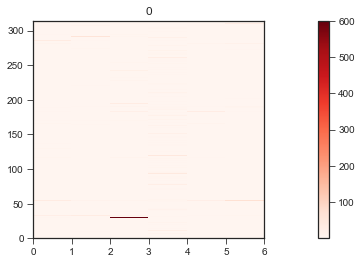

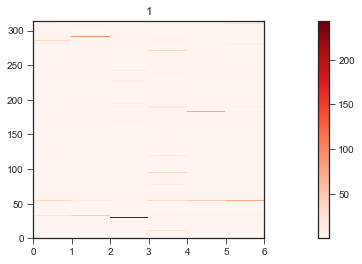

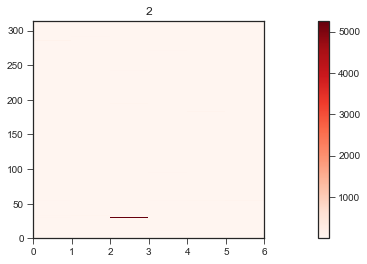

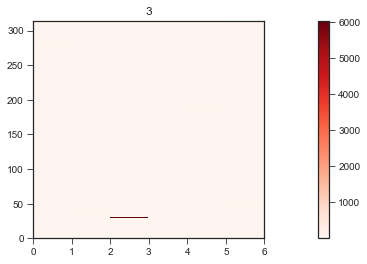

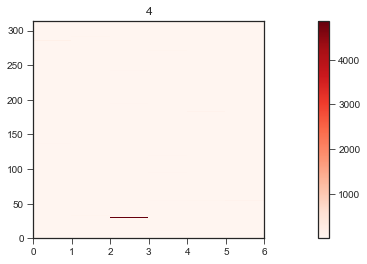

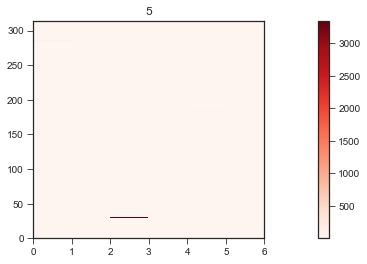

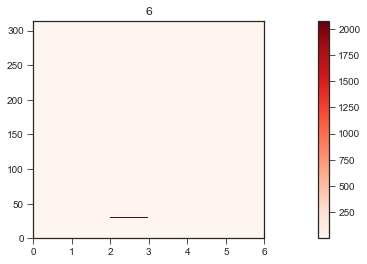

In [42]:
test_measured = this_fitness[test[1],:][:,test[0]]

removals = [42]

pared_guesses = [guesses[rank][w] for rank in range(len(guesses))]
 
for rank in range(len(guesses)):
    fig = plt.figure()
    plt.title(rank)
    pcm = plt.pcolormesh(np.abs((guesses[rank]-test_measured)/test_measured),cmap='Reds')
    cbar = fig.colorbar(pcm,pad=0.16)

1BB_Baffle
1BB_1.4%Gluc
1BB_1.8%Gluc
1BB_0.2MNaCl
1BB_0.2MKCl
1BB_0.5MKCl
1BB_1%Raf
1BB_0.5%Raf
1BB_1%Gly


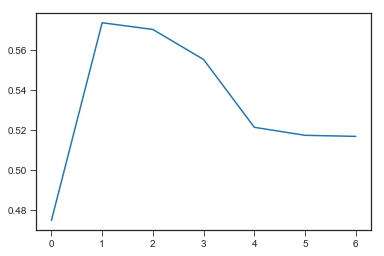

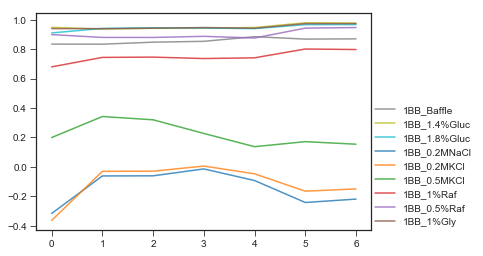

In [64]:

train_conditions = train_cols
# train_conditions = test_cols
train_locs = np.where(np.isin(fitness_cols,train_conditions))[0]

test_conditions = test_cols
# test_conditions = train_cols
# test_conditions = [rep for rep in  test_conditions if rep.split('_')[0] in all_reps]
test_locs = np.where(np.isin(fitness_cols,test_conditions))[0]




all_locs = sorted(list(train_locs)+list(test_locs))

this_fitness = fitness[:,all_locs]
new_train_locs = np.where(np.isin(all_locs,train_locs))[0]
new_test_locs = np.where(np.isin(all_locs,test_locs))[0]



train = [new_train_locs,np.where(np.isin(this_data['barcode'].values,training_bcs))[0]]
test = [new_test_locs,np.where(~np.isin(this_data['barcode'].values,training_bcs))[0]]


by_rank, by_condition, by_mutant, mean_fits, guesses = tools.SVD_predictions_train_test(this_fitness,train,test,by_condition=True,by_mutant=True)
by_condition = np.asarray(by_condition).swapaxes(0,1)

condition_colors = sns.color_palette()
plt.plot(by_rank)
plt.figure()
start = 0
already_plotted = []



for k,condition in enumerate(test_conditions):
    condition = condition.split('_fitness')[0]
    print(condition)
#     condition_name = [name for name, reps in conditions.items() for rep in reps if rep == condition][0]
    condition_name = condition
    index = np.where(np.asarray(list(conditions.keys()))==condition_name)[0][0]
    
    index =  index % len(condition_colors)
    if condition_name not in already_plotted:
        plt.plot(by_condition[k],label=condition_name,color=condition_colors[index],alpha=0.8)
        already_plotted.append(condition_name)
    else:
        plt.plot(by_condition[k],color=condition_colors[index],alpha=0.8)
plt.legend(loc=(1.0,0.0))

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/matplotlib/legend.py:593: UserWarning: The handle <matplotlib.lines.Line2D object at 0x1168ec470> has a label of '_nolegend_' which cannot be automatically added to the legend.
  'legend.'.format(handle, label))
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/matplotlib/legend.py:593: UserWarning: The handle <matplotlib.collections.PathCollection object at 0x1168d8b00> has a label of '_nolegend_' which cannot be automatically added to the legend.
  'legend.'.format(handle, label))
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/matplotlib/legend.py:593: UserWarning: The handle <matplotlib.lines.Line2D object at 0x11aaac588> has a label of '_nolegend_' which cannot be automatically added to the legend.
  'legend.'.format(handle, label))
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/matplotlib/legend.py:593: UserWarning:

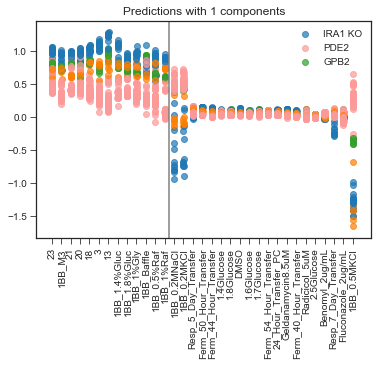

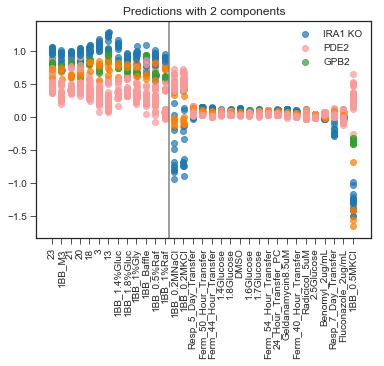

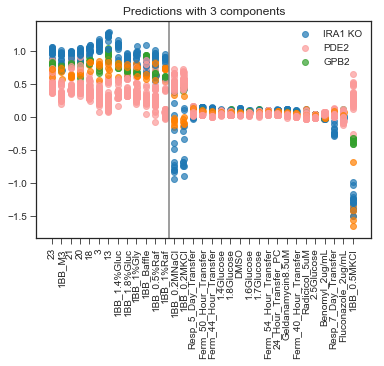

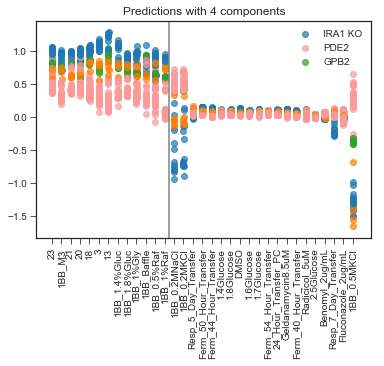

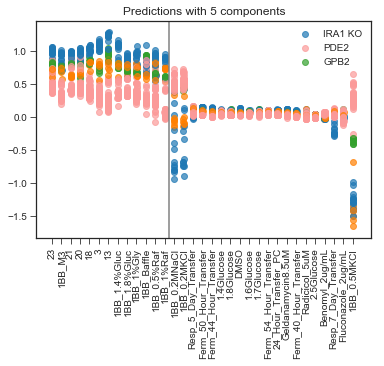

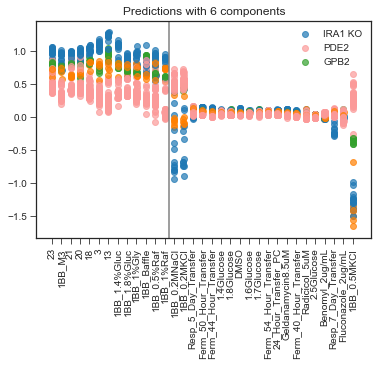

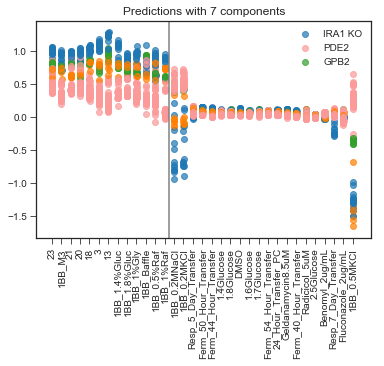

In [70]:
test_mutant_data = this_data[~this_data['barcode'].isin(training_bcs)]

train_conditions = train_cols
test_conditions = test_cols


this_gene = ['GPB2','PDE2','IRA1','Diploid']
# this
this_gene_data = test_mutant_data[test_mutant_data['gene'].isin(this_gene)]

# type_list = ['nonsense_variant','frameshift_variant']
# type_list = ['missense_variant']
# this_gene_data = this_gene_data[this_gene_data['type'].isin(type_list)]


this_gene_locs = np.where(np.isin(test_mutant_data['barcode'].values,this_gene_data['barcode'].values))[0]
jitters = [tools.jitter_point(0,0.01) for bc in range(len(this_gene_data[train_conditions[0]].values)) ]

for rank in range(7):
    plt.figure()
    plt.title(f'Predictions with {rank+1} components')
    for i,col in enumerate(train_conditions):
        for bc in range(len(this_gene_data[col].values)):
            plt.scatter([i + 1 + jitters[bc]],this_gene_data[col].values[bc],alpha=0.7,color=mutant_colorset[this_gene_data['gene'].values[bc]]) 
    
    for i,col in enumerate(test_conditions):
        for bc in range(len(this_gene_data[col].values)):
            plt.scatter([len(train_conditions)+i + 1 + jitters[bc]],this_gene_data[col].values[bc],alpha=0.7,color=mutant_colorset[this_gene_data['gene'].values[bc]]) 
    
#     plt.gca().set_prop_cycle(None)
#     for i,col in enumerate(test_conditions):
#         for bc in range(len(this_gene_data[col].values)):
#             plt.scatter([len(train_conditions)+i + 1 + 0.5 + jitters[bc]],guesses[rank][this_gene_locs[bc],i],alpha=0.7,color=mutant_colorset[this_gene_data['gene'].values[bc]]) 
#     sns.boxplot(data=guesses[rank][this_gene_locs,:])
    
    plt.axvline(x=len(train_conditions)+0.5,color='gray')
    plt.legend(['_nolegend_','IRA1 KO','PDE2','_nolegend_','GPB2'])
    plt.xticks(range(1,len(train_conditions)+len(test_conditions)+1),[col.split('_fitness')[0] for col in (train_conditions + test_conditions)],rotation=90)
    
    
#     plt.savefig('predictions_by_gene_{rank+1}components.pdf',bbox_inches='tight')

In [ ]:
test_mutant_data = this_data[~this_data['barcode'].isin(minimal_training_bcs)]


# this_gene = ['GPB2','PDE2','IRA1','Diploid']
# this
# this_gene_data = test_mutant_data[test_mutant_data['gene'].isin(this_gene)]

this_gene_data = test_mutant_data

# type_list = ['nonsense_variant','frameshift_variant']
# type_list = ['missense_variant']
# this_gene_data = this_gene_data[this_gene_data['type'].isin(type_list)]


this_gene_locs = np.where(np.isin(test_mutant_data['barcode'].values,this_gene_data['barcode'].values))[0]
jitters = [tools.jitter_point(0,0.01) for bc in range(len(this_gene_data[train_conditions[0]].values)) ]

for i,col in enumerate(test_conditions):
    for rank in range(len(guesses)):
        plt.figure()
        plt.title(f'{col} - {rank+1}')
        for bc in range(len(this_gene_data[col].values)):
            plt.scatter(this_gene_data[col].values[bc],guesses[rank][this_gene_locs[bc],i],color=mutant_colorset[this_gene_data['gene'].values[bc]],alpha=0.6)
        
        xmin,xmax = plt.xlim()
        ymin,ymax = plt.ylim()
        plt.xlim(min(xmin,ymin),max(xmax,ymax))
        plt.ylim(min(xmin,ymin),max(xmax,ymax))
        plt.tight_layout()
        plt.gca().set_aspect('equal')
        plt.xlabel('Measured Fitness')
        plt.ylabel('Predicted Fitness')
        plt.savefig(f'predictions_by_gene_sidebyside_withold_minimalmutants_{col}_{rank+1}components.pdf',bbox_inches='tight')

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


KeyboardInterrupt: 

In [74]:
this_data[this_data['barcode']==this_data['barcode'].values[55]][train_conditions+test_conditions].values

array([[-0.0797669 ,  0.01417236, -0.05644245, -0.05836564, -0.04170214,
        -0.02043665,  0.00849465, -0.01985987,  0.03937098,  0.01264094,
         0.06193405,  0.00542039, -0.01789558,  0.03744408, -0.05614371,
        -0.02542603]])

In [85]:
this_data[this_data['class'].isin(['ExpNeutral'])]

,barcode,gene,type,ploidy,class,additional_muts,13.1_T1to2_error,13.1_T1to2_fitness,13.1_T2to3_error,13.1_T2to3_fitness,...,D.DE1.PCRb.1-D.DE1.PCRb.2_error,D.DE1.PCRb.1-D.DE1.PCRb.2_fitness,D.DE1.PCRb.2-D.DE1.PCRa.3_error,D.DE1.PCRb.2-D.DE1.PCRa.3_fitness,D.DE1.PCRb.2-D.DE1.PCRb.3_error,D.DE1.PCRb.2-D.DE1.PCRb.3_fitness,D.DE1.PCRb.3-D.DE1.PCRa.4_error,D.DE1.PCRb.3-D.DE1.PCRa.4_fitness,D.DE1.PCRb.3-D.DE1.PCRb.4_error,D.DE1.PCRb.3-D.DE1.PCRb.4_fitness
292,72939,NotSequenced,NotSequenced,NotSequenced,ExpNeutral,NotSequenced,1.0,0.058130,1.0,0.044166,...,1.0,-0.106077,1.0,0.104692,1.0,0.231084,1.0,-0.064463,1.0,-0.038010
357,120600,other,other,other,ExpNeutral,nan-upstream_indel_variant,1.0,-0.022603,1.0,-0.036836,...,1.0,0.085671,1.0,-0.262471,1.0,-0.011153,1.0,-0.074272,1.0,0.052239
474,298344,other,other,other,ExpNeutral,FYV10-upstream_indel_variant; YKL177W-upstream...,1.0,-0.190787,1.0,0.170166,...,1.0,-0.140856,1.0,0.389522,1.0,0.212395,1.0,0.038669,1.0,-0.012900


In [88]:
this_data[this_data['gene']=='other']

,barcode,gene,type,ploidy,class,additional_muts,13.1_T1to2_error,13.1_T1to2_fitness,13.1_T2to3_error,13.1_T2to3_fitness,...,D.DE1.PCRb.1-D.DE1.PCRb.2_error,D.DE1.PCRb.1-D.DE1.PCRb.2_fitness,D.DE1.PCRb.2-D.DE1.PCRa.3_error,D.DE1.PCRb.2-D.DE1.PCRa.3_fitness,D.DE1.PCRb.2-D.DE1.PCRb.3_error,D.DE1.PCRb.2-D.DE1.PCRb.3_fitness,D.DE1.PCRb.3-D.DE1.PCRa.4_error,D.DE1.PCRb.3-D.DE1.PCRa.4_fitness,D.DE1.PCRb.3-D.DE1.PCRb.4_error,D.DE1.PCRb.3-D.DE1.PCRb.4_fitness
16,1641,other,other,other,other,nan-nan,1.0,0.183488,1.0,0.055235,...,1.0,-0.174079,1.0,0.107723,1.0,0.094027,1.0,0.094105,1.0,0.199129
17,1683,other,other,other,other,SDH3-upstream_point_variant; MFM1-missense_var...,1.0,0.092495,1.0,-0.178251,...,1.0,-0.023457,1.0,0.090384,1.0,-0.103985,1.0,0.236495,1.0,0.245908
53,7291,other,other,other,other,"IMP4-missense_variant; YER156C,COG3-upstream_i...",1.0,-0.122278,1.0,0.003392,...,1.0,-0.036893,1.0,0.058277,1.0,0.066181,1.0,0.085515,1.0,-0.120820
56,7538,other,other,other,other,SEC31-synonymous_variant; ERG1-missense_varian...,1.0,0.892983,1.0,0.598109,...,1.0,-0.038893,1.0,-0.197483,1.0,0.066257,1.0,-0.039292,1.0,0.147415
62,7953,other,other,other,other,nan-nan,1.0,1.212985,1.0,1.076551,...,1.0,0.806385,1.0,0.891071,1.0,0.653368,1.0,0.732599,1.0,0.802753
68,8825,other,other,other,other,ATG32-upstream_indel_variant,1.0,-0.003088,1.0,-0.126550,...,1.0,-0.193931,1.0,-0.214006,1.0,0.232056,1.0,0.032620,1.0,-0.076126
77,10307,other,other,other,other,nan-nan,1.0,0.151889,1.0,0.080794,...,1.0,-0.160825,1.0,0.162019,1.0,-0.236642,1.0,0.114391,1.0,0.064709
97,13183,other,other,other,other,nan-nan,1.0,1.418840,1.0,1.330550,...,1.0,0.102428,1.0,-0.224542,1.0,-0.175302,1.0,0.017579,1.0,0.090621
113,17499,other,other,other,other,LCP5-upstream_indel_variant; PTC3-synonymous_v...,1.0,-0.169470,1.0,0.444566,...,1.0,-0.099572,1.0,-0.256100,1.0,0.047418,1.0,0.251171,1.0,0.008007
117,18152,other,other,other,other,KTI12-missense_variant,1.0,1.436099,1.0,1.338601,...,1.0,0.930502,1.0,1.074372,1.0,1.115791,1.0,0.934102,1.0,0.920605


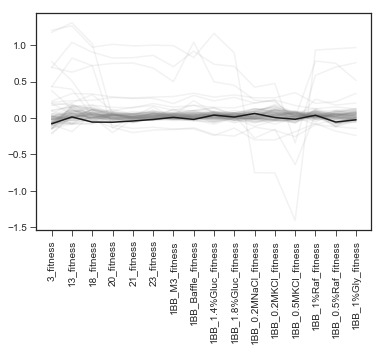

In [91]:
# np.where(guesses[1][:,6] > 1.5)
for bc in this_data[this_data['gene']=='other']['barcode'].values:
    plt.plot(this_data[this_data['barcode']==bc][train_conditions+test_conditions].values[0],color='gray',alpha=0.1)




# for bc in neutrals:
#     if bc in this_data['barcode'].values:
#         plt.plot(this_data[this_data['barcode']==bc][train_conditions+test_conditions].values[0],color='gray')

plt.plot(this_data[this_data['barcode']==this_data['barcode'].values[55]][train_conditions+test_conditions].values[0],color='k')
plt.xticks(range(len(train_conditions+test_conditions)),train_conditions+test_conditions,rotation=90)
plt.savefig('weirdly_predicted_neutral_Raffionse.pdf',bbox_inches='tight')

In [53]:
test_mutant_data = this_data[~this_data['barcode'].isin(training_bcs)]


this_gene = ['GPB2','PDE2','IRA1']
# this
this_gene_data = test_mutant_data[test_mutant_data['gene'].isin(this_gene)]

type_list = ['nonsense_variant','frameshift_variant']
# type_list = ['missense_variant']
this_gene_data = this_gene_data[this_gene_data['type'].isin(type_list)]


this_gene_locs = np.where(np.isin(test_mutant_data['barcode'].values,this_gene_data['barcode'].values))[0]
jitters = [tools.jitter_point(0,0.01) for bc in range(len(this_gene_data[col].values)) ]

for rank in range(7):
    plt.figure()
    plt.title(f'Predictions with {rank+1} components')
    for i,col in enumerate(train_conditions):
        for bc in range(len(this_gene_data[col].values)):
            plt.scatter([i + 1 + jitters[bc]],this_gene_data[col].values[bc],alpha=0.7,color=mutant_colorset[this_gene_data['gene'].values[bc]]) 
    
    for i,col in enumerate(test_conditions):
        for bc in range(len(this_gene_data[col].values)):
            plt.scatter([len(train_conditions)+i + 1 + jitters[bc]],this_gene_data[col].values[bc],alpha=0.7,color=mutant_colorset[this_gene_data['gene'].values[bc]]) 
    
    plt.gca().set_prop_cycle(None)
#     for i,col in enumerate(test_conditions):
#         for bc in range(len(this_gene_data[col].values)):
#             plt.scatter([len(train_conditions)+i + 1 + 0.5 + jitters[bc]],guesses[rank][this_gene_locs[bc],i],alpha=0.7,color=mutant_colorset[this_gene_data['gene'].values[bc]]) 
    sns.boxplot(data=guesses[rank][this_gene_locs,:])
    
    plt.axvline(x=len(train_conditions)+0.5,color='gray')
    plt.legend(['_nolegend_','IRA1 KO','PDE2','_nolegend_','GPB2'])
    plt.xticks(range(1,len(train_conditions)+len(test_conditions)+1),[col.split('_fitness')[0] for col in (train_conditions + test_conditions)],rotation=90)
    
    
#     plt.savefig('predictions_by_gene_{rank+1}components.pdf',bbox_inches='tight')

NameError: name 'col' is not defined

1BB_Baffle
1BB_1.4%Gluc
1BB_1.8%Gluc
1BB_0.2MNaCl
1BB_0.2MKCl
1BB_0.5MKCl
1BB_1%Raf
1BB_0.5%Raf
1BB_1%Gly


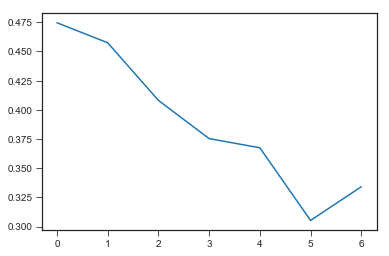

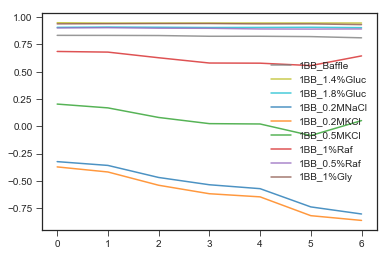

In [96]:

train_conditions = train_cols
# train_conditions = test_cols
train_locs = np.where(np.isin(fitness_cols,train_conditions))[0]

test_conditions = test_cols
# test_conditions = train_cols
# test_conditions = [rep for rep in  test_conditions if rep.split('_')[0] in all_reps]
test_locs = np.where(np.isin(fitness_cols,test_conditions))[0]




all_locs = sorted(list(train_locs)+list(test_locs))

this_fitness = fitness[:,all_locs]
new_train_locs = np.where(np.isin(all_locs,train_locs))[0]
new_test_locs = np.where(np.isin(all_locs,test_locs))[0]



train = [new_train_locs,np.where(np.isin(this_data['barcode'].values,training_bcs))[0]]
test = [new_test_locs,np.where(~np.isin(this_data['barcode'].values,training_bcs))[0]]


by_rank, by_condition, by_mutant, mean_fits, guesses = tools.SVD_predictions_train_test(this_fitness,train,test,by_condition=True,by_mutant=True,permuted_mutants=True)
by_condition = np.asarray(by_condition).swapaxes(0,1)

condition_colors = sns.color_palette()
plt.plot(by_rank)
plt.figure()
start = 0
already_plotted = []



for k,condition in enumerate(test_conditions):
    condition = condition.split('_fitness')[0]
    print(condition)
#     condition_name = [name for name, reps in conditions.items() for rep in reps if rep == condition][0]
    condition_name = condition
    index = np.where(np.asarray(list(conditions.keys()))==condition_name)[0][0]
    
    index =  index % len(condition_colors)
    if condition_name not in already_plotted:
        plt.plot(by_condition[k],label=condition_name,color=condition_colors[index],alpha=0.8)
        already_plotted.append(condition_name)
    else:
        plt.plot(by_condition[k],color=condition_colors[index],alpha=0.8)
plt.legend()

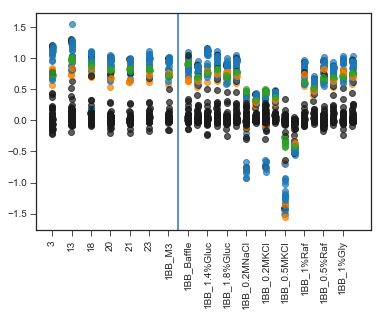

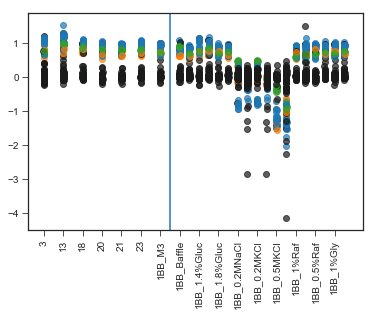

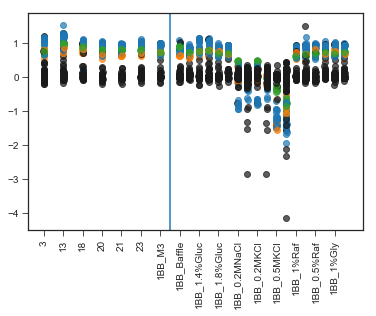

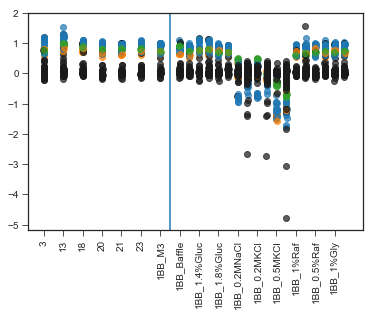

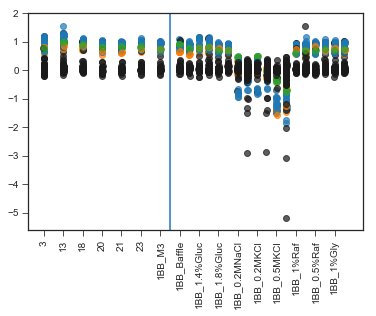

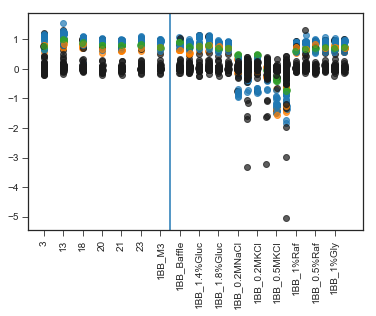

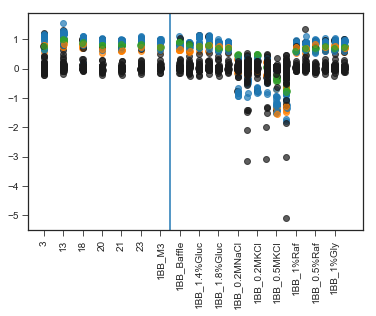

In [215]:
test_mutant_data = this_data[~this_data['barcode'].isin(training_bcs)]


this_gene = ['GPB2','PDE2','IRA1','other']
this_gene_data = test_mutant_data[test_mutant_data['gene'].isin(this_gene)]

# type_list = ['nonsense_variant','frameshift_variant']
# type_list = ['missense_variant']
# this_gene_data = this_gene_data[this_gene_data['type'].isin(type_list)]


this_gene_locs = np.where(np.isin(test_mutant_data['barcode'].values,this_gene_data['barcode'].values))[0]
jitters = [tools.jitter_point(0,0.01) for bc in range(len(this_gene_data[col].values)) ]

for rank in range(7):
    plt.figure()
    for i,col in enumerate(train_conditions):
        for bc in range(len(this_gene_data[col].values)):
            plt.scatter([i + 1 + jitters[bc]],this_gene_data[col].values[bc],alpha=0.7,color=mutant_colorset[this_gene_data['gene'].values[bc]]) 
    
    for i,col in enumerate(test_conditions):
        for bc in range(len(this_gene_data[col].values)):
            plt.scatter([len(train_conditions)+i + 1 + jitters[bc]],this_gene_data[col].values[bc],alpha=0.7,color=mutant_colorset[this_gene_data['gene'].values[bc]]) 
    
    plt.gca().set_prop_cycle(None)
    for i,col in enumerate(test_conditions):
        for bc in range(len(this_gene_data[col].values)):
            plt.scatter([len(train_conditions)+i + 1 + 0.5 + jitters[bc]],guesses[rank][this_gene_locs[bc],i],alpha=0.7,color=mutant_colorset[this_gene_data['gene'].values[bc]]) 
#     plt.boxplot(guesses[rank][this_gene_locs,:])
    plt.axvline(x=len(train_conditions)+0.5)
    plt.xticks(range(1,len(train_conditions)+len(test_conditions)+1),[col.split('_fitness')[0] for col in (train_conditions + test_conditions)],rotation=90)

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


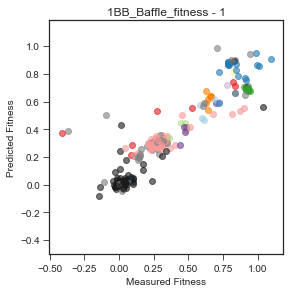

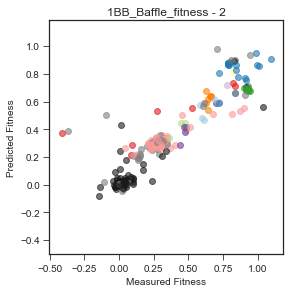

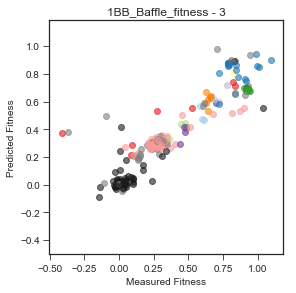

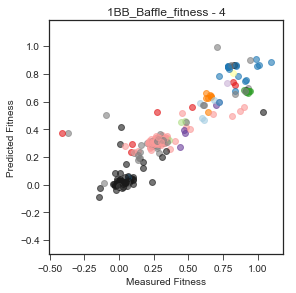

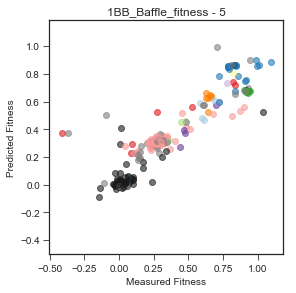

...

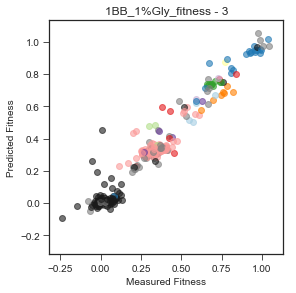

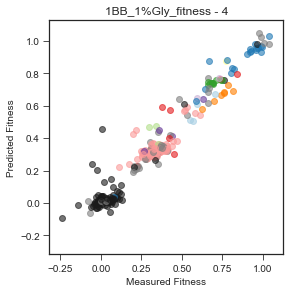

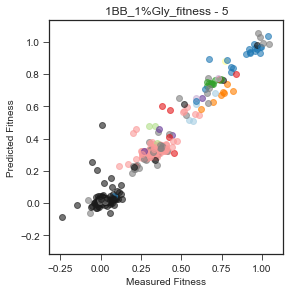

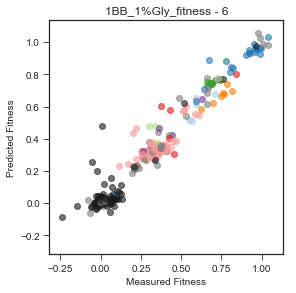

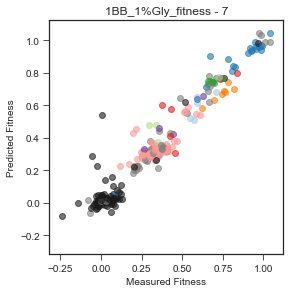

In [97]:
test_mutant_data = this_data[~this_data['barcode'].isin(training_bcs)]


# this_gene = ['GPB2','PDE2','IRA1','Diploid']
# this
# this_gene_data = test_mutant_data[test_mutant_data['gene'].isin(this_gene)]

this_gene_data = test_mutant_data

# type_list = ['nonsense_variant','frameshift_variant']
# type_list = ['missense_variant']
# this_gene_data = this_gene_data[this_gene_data['type'].isin(type_list)]


this_gene_locs = np.where(np.isin(test_mutant_data['barcode'].values,this_gene_data['barcode'].values))[0]
jitters = [tools.jitter_point(0,0.01) for bc in range(len(this_gene_data[train_conditions[0]].values)) ]

for i,col in enumerate(test_conditions):
    for rank in range(len(guesses)):
        plt.figure()
        plt.title(f'{col} - {rank+1}')
        for bc in range(len(this_gene_data[col].values)):
            plt.scatter(this_gene_data[col].values[bc],guesses[rank][this_gene_locs[bc],i],color=mutant_colorset[this_gene_data['gene'].values[bc]],alpha=0.6)
        
        xmin,xmax = plt.xlim()
        ymin,ymax = plt.ylim()
        plt.xlim(min(xmin,ymin),max(xmax,ymax))
        plt.ylim(min(xmin,ymin),max(xmax,ymax))
        plt.tight_layout()
        plt.gca().set_aspect('equal')
        plt.xlabel('Measured Fitness')
        plt.ylabel('Predicted Fitness')
        plt.savefig(f'predictions_by_gene_sidebyside_permuted_{col}_{rank+1}components.pdf',bbox_inches='tight')

In [12]:
p = Pool(10)
entries = [[this_fitness,train,test,n_components] for n_components in range(1,25)]
# (,by_condition=True,by_mutant=False)
output = p.starmap(tools.SVD_predictions_train_test_mixnmatch,entries)

KeyboardInterrupt: 

Process ForkPoolWorker-39:
Process ForkPoolWorker-35:
Process ForkPoolWorker-38:
Process ForkPoolWorker-40:
Process ForkPoolWorker-32:
Process ForkPoolWorker-37:
Process ForkPoolWorker-34:
Process ForkPoolWorker-33:
Process ForkPoolWorker-36:
Process ForkPoolWorker-31:
Traceback (most recent call last):
  File "/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
Traceback (most recent call last):
  File "/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
Traceback (most recent call last):
  File "/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/multiprocessing/process.py", line 93, in run
    self._target(*self._args, **self._kwargs)
  File "/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/Library/Frameworks/Python.framewo

  File "/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/numpy/linalg/linalg.py", line 1724, in pinv
    u, s, vt = svd(a, full_matrices=False)
  File "/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/numpy/linalg/linalg.py", line 1444, in svd
    u, s, vh = gufunc(a, signature=signature, extobj=extobj)
  File "/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/numpy/linalg/linalg.py", line 1444, in svd
    u, s, vh = gufunc(a, signature=signature, extobj=extobj)
  File "/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/multiprocessing/pool.py", line 119, in worker
    result = (True, func(*args, **kwds))
  File "/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/numpy/linalg/linalg.py", line 1444, in svd
    u, s, vh = gufunc(a, signature=signature, extobj=extobj)
  File "/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/numpy/linalg

In [36]:
%%time
if __name__ ==  '__main__': 
    p = Pool(10)
    entries = [[this_fitness,train,test,n_components,False,False] for n_components in range(1,25)]
    # (,by_condition=True,by_mutant=False)
    output = p.starmap(tools.SVD_predictions_train_test_mixnmatch,entries)

CPU times: user 1min 36s, sys: 1min 20s, total: 2min 56s
Wall time: 1h 13min 51s


In [50]:
output[0][0]

[0.7775464290186149,
 -1.7462627649199987,
 -1.7322641952199276,
 -1.8075848574009248,
 -1.8071511589631837,
 -1.8039558786969931,
 -1.8103381478808624,
 -1.8074569334136434,
 -1.7884100100802862,
 -1.794749121032754,
 -1.8362844687658728,
 -1.8034855936533494,
 -1.893842230766019,
 -1.8112373698713573,
 -1.816097188453781,
 -1.8124588165782156,
 -1.8164305059075976,
 -1.8163543693231108,
 -1.8102422591361833,
 -1.796341314905836,
 -1.8078083617314307,
 -1.804494066515543,
 -1.8175237432201117,
 -1.794151939431321]

In [54]:
sort_list = []
for o in output:
    sort_list.append(sorted([(o1,o2) for o1,o2 in zip(o[0],o[4])],reverse=True))
    

In [55]:
sorted_rank_combos = sort_list

RuntimeError: Failed to open TrueType font

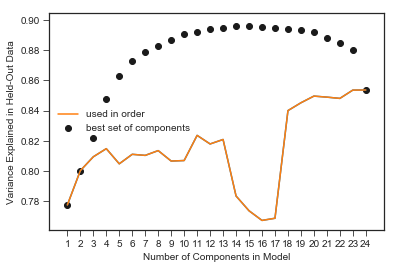

In [57]:
by_rank, by_condition, by_mutant, mean_fits = tools.SVD_predictions_train_test(this_fitness,train,test,by_condition=True,by_mutant=False)
# by_condition = np.asarray(by_condition).swapaxes(0,1)

condition_colors = sns.color_palette()
plt.plot(by_rank)

for rank in range(len(sorted_rank_combos)):
    plt.scatter(rank,sorted_rank_combos[rank][0][0],color='k',label='best set of components' if rank ==0 else '_nolegend_')
plt.plot(by_rank,label='used in order')
# plt.savefig('predictions_best_per_rank.pdf',bbox_inches='tight')
plt.xticks(range(len(by_rank)),range(1,len(by_rank)+1))
plt.xlabel('Number of Components in Model')
plt.ylabel('Variance Explained in Held-Out Data')
plt.legend()
plt.savefig('best_set_vs_in_order_all.pdf',bbox_inches='tight')

In [31]:
%%time
o = []
for n_components in range(1,5):
    by_rank, by_condition, by_mutant, mean_fits, component_sets = tools.SVD_predictions_train_test_mixnmatch(this_fitness,train,test,n_components,by_condition=True,by_mutant=False)
    o.append(sorted([(rank,combo) for rank,combo in zip(by_rank,component_sets)],reverse=True))



CPU times: user 15.1 s, sys: 470 ms, total: 15.6 s
Wall time: 34.6 s


In [63]:
sorted_rank_combos[6]

[(0.8785819075879436, [0, 1, 2, 9, 10, 12, 17]),
 (0.8770446318593077, [0, 1, 2, 7, 10, 12, 17]),
 (0.8763761257533184, [0, 1, 2, 3, 10, 12, 17]),
 (0.876272100070757, [0, 1, 2, 5, 10, 12, 17]),
 (0.8752940410415991, [0, 1, 2, 10, 12, 17, 19]),
 (0.8739377955644658, [0, 1, 2, 10, 12, 16, 17]),
 (0.8737460397343314, [0, 1, 2, 6, 10, 12, 17]),
 (0.873565355369854, [0, 1, 2, 10, 11, 12, 17]),
 (0.87297186151656, [0, 1, 2, 3, 8, 10, 17]),
 (0.8727238941920381, [0, 1, 2, 10, 12, 17, 23]),
 (0.8723689696864775, [0, 1, 2, 10, 12, 17, 21]),
 (0.8722390689577192, [0, 1, 2, 10, 12, 17, 20]),
 (0.8714454687763196, [0, 1, 2, 7, 8, 10, 17]),
 (0.8713969764924173, [0, 1, 2, 8, 10, 17, 19]),
 (0.8708718512808002, [0, 1, 2, 10, 12, 17, 18]),
 (0.8708306655632606, [0, 1, 2, 5, 8, 10, 17]),
 (0.8707817426646477, [0, 1, 2, 8, 10, 14, 17]),
 (0.8707719842860515, [0, 1, 2, 3, 5, 10, 17]),
 (0.8704256336135026, [0, 1, 2, 8, 10, 16, 17]),
 (0.870276423848967, [0, 1, 2, 3, 7, 10, 17]),
 (0.8699833141457991, [

In [ ]:
this_data = merged_fitness_data
this_data = this_data.replace([np.inf, -np.inf], np.nan)
this_data = this_data.dropna('columns',how='all')
this_data = this_data.dropna()

this_data = this_data.sort_values('barcode')

bests = []
ranks = []

# train_cols = [col + '_fitness' for col in m3_conditions]
# test_cols = [col + '_fitness' for col in bigbatch_conditions.keys() if (col + '_fitness') not in train_cols]
# test_cols = test_cols + [col + '_fitness' for col in old_nonm3_conditions]

train_cols = [col + '_fitness' for col in train_cols]
test_cols = [col + '_fitness' for col in test_cols]

fitness_cols = train_cols + test_cols

train_locs = np.where(np.isin(fitness_cols,train_cols))[0]
test_locs = np.where(np.isin(fitness_cols,test_cols))[0]

all_locs = sorted(list(train_locs)+list(test_locs))

fitness = this_data[fitness_cols].values
new_train_locs = np.where(np.isin(all_locs,train_locs))[0]
new_test_locs = np.where(np.isin(all_locs,test_locs))[0]

this_fitness = fitness[:,all_locs]

test_mutants = np.where(~np.isin(this_data['barcode'].values,training_bcs))[0]

mean_guess = tools.var_explained(this_fitness[test_mutants,:][:,new_test_locs],np.repeat(np.mean(this_fitness[test_mutants,:][:,new_train_locs],axis=1),len(new_test_locs)).reshape(len(test_mutants),len(new_test_locs)))

for bootstrap in [False]+ list(range(100)):
    if bootstrap != False:
        train_cols = [col.split('_fitness')[0] + f'_bootstrap{bootstrap}_fitness' for col in train_cols]
        test_cols = [col for col in bigbatch_conditions.keys() if (col) not in train_cols]

    else:
        train_cols = [col for col in train_cols]
        test_cols = [col for col in bigbatch_conditions.keys() if (col) not in train_cols]


    fitness_cols = train_cols + test_cols

    fitness = this_data[fitness_cols].values

    n_mutants = fitness.shape[0]
    n_conditions = fitness.shape[1]
    
    train_conditions = train_cols

    # train_conditions = test_cols
    train_locs = np.where(np.isin(fitness_cols,train_conditions))[0]

    test_conditions = test_cols
    # test_conditions = train_cols
    # test_conditions = [rep for rep in  test_conditions if rep.split('_')[0] in all_reps]
    test_locs = np.where(np.isin(fitness_cols,test_conditions))[0]




    all_locs = sorted(list(train_locs)+list(test_locs))

    this_fitness = fitness[:,all_locs]
    new_train_locs = np.where(np.isin(all_locs,train_locs))[0]
    new_test_locs = np.where(np.isin(all_locs,test_locs))[0]



    train = [new_train_locs,np.where(np.isin(this_data['barcode'].values,training_bcs))[0]]
    test = [new_test_locs,np.where(~np.isin(this_data['barcode'].values,training_bcs))[0]]


    by_rank, by_condition, by_mutant, mean_fits, guesses = tools.SVD_predictions_train_test(this_fitness,train,test,by_condition=True,by_mutant=True)
    by_condition = np.asarray(by_condition).swapaxes(0,1)
    
#     bests.append(max(by_rank))
    bests.append(by_rank[1])
    
    ranks.append(np.where(by_rank==max(by_rank))[0])


